In [12]:
# Add directory above current directory to path
import sys as SYS; SYS.path.insert(0, '..')

# for saving
import os
from matplotlib.colors import LinearSegmentedColormap

from collections import defaultdict
import numpy as np
import matplotlib.pyplot as plt

from src import setup
# setup.use_gpu()

In [2]:
from src import ( 
    measurements as measure,
    density_matrix as DM,
    simulation as sim,
    orders,
    order_rules,
    random_unitary,
    simulation)

from Scripts import simulation_CLI as cleo

In [3]:
import matplotlib.pyplot as plt 
import matplotlib.colors as mcolors 

import matplotlib.animation as animation
# Add directory above current directory to path
import sys as SYS; SYS.path.insert(0, '../..')
import h5py
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
from src import ket as ket
from src import density_matrix as DM

In [4]:
#pick={therm,inhomov1,inhomov2,pure} pick one of these to properly store images with the correct labels
dataset_label = "therm"
#network size i.e num of qubits
size=12


In [ ]:
#Load data

In [46]:
import sys as SYS; SYS.path.insert(0, '../..')
from Scripts import hdf5merge
#hdf5merge.merge_hdf5_files("../data/unnati_submit_12_pure_strongmax")
#hdf5merge.merge_hdf5_files("../data/unnati_submit_12_pure_greedy")
#hdf5merge.merge_hdf5_files("../data/unnati_submit_12_pure_random")
hdf5merge.merge_hdf5_files("../data/unnati_submit_12_pure_landmax")
#hdf5merge.merge_hdf5_files("../data/unnati_submit_12_pure_mimic")

In [37]:
import sys as SYS; SYS.path.insert(0, '../..')
from Scripts import hdf5merge
#hdf5merge.merge_hdf5_files("../data/unnati_submit_12_inhomo_v1_strong_max")
#hdf5merge.merge_hdf5_files("../data/unnati_submit_12_inhomo_v1_greedy")
#hdf5merge.merge_hdf5_files("../data/unnati_submit_12_inhomo_v1_random")
hdf5merge.merge_hdf5_files("../data/unnati_submit_12_inhomo_v1_random_cn")
#hdf5merge.merge_hdf5_files("../data/unnati_submit_12_inhomo_v1_landmax")
#hdf5merge.merge_hdf5_files("../data/unnati_submit_12_inhomo_v1_mimic_cn")
#hdf5merge.merge_hdf5_files("../data/unnati_submit_12_inhomo_v1_mimic")

In [ ]:
import sys as SYS; SYS.path.insert(0, '../..')
from Scripts import hdf5merge
#hdf5merge.merge_hdf5_files("../data/unnati_submit_12_inhomo_v2_strongmax")
#hdf5merge.merge_hdf5_files("../data/unnati_submit_12_inhomo_v2_greedy")
#hdf5merge.merge_hdf5_files("../data/unnati_submit_12_inhomo_v2_random")
#hdf5merge.merge_hdf5_files("../data/unnati_submit_12_inhomo_v2_landmax")
#hdf5merge.merge_hdf5_files("../data/unnati_submit_12_inhomo_v2_mimic")
hdf5merge.merge_hdf5_files("../data/unnati_submit_12_inhomo_v1_random_cn_1000_steps")

In [ ]:
import sys as SYS; SYS.path.insert(0, '../..')
from Scripts import hdf5merge
hdf5merge.merge_hdf5_files("../data/unnati_submit_12_inhomo_v1_mimic_cn_1000_steps")

In [19]:
newdata5 = dict(h5py.File("../data/Sarah_10/unnati_submit_10_therm/strongmax.hdf5"))
newdata2 = dict(h5py.File("../data/Sarah_10/unnati_submit_10_therm/greedy.hdf5"))
newdata3 = dict(h5py.File("../data/Sarah_10/unnati_submit_10_therm/mimic.hdf5"))
newdata4 = dict(h5py.File("../data/Sarah_10/unnati_submit_10_therm/landmax.hdf5"))
newdata1 = dict(h5py.File("../data/Sarah_10/unnati_submit_10_therm/random.hdf5"))

In [40]:
newdata5 = dict(h5py.File("../data/unnati_submit_12_inhomo_v1_strong_max/unnati_submit_12_inhomo_v1_strong_max.hdf5"))
newdata2 = dict(h5py.File("../data/unnati_submit_12_inhomo_v1_greedy/unnati_submit_12_inhomo_v1_greedy.hdf5"))
newdata3 = dict(h5py.File("../data/unnati_submit_12_inhomo_v1_mimic/unnati_submit_12_inhomo_v1_mimic.hdf5"))
newdata4 = dict(h5py.File("../data/unnati_submit_12_inhomo_v1_landmax/unnati_submit_12_inhomo_v1_landmax.hdf5"))
newdata1 = dict(h5py.File("../data/unnati_submit_12_inhomo_v1_random/unnati_submit_12_inhomo_v1_random.hdf5"))

In [6]:
def get_pops(data, n_qubits, connectivity,update_rule):
    #dimension 0 is each trial
    #dimension 1 is each time step
    #dimension 2 is each qubit
    result = []
    for trial in data[f'{n_qubits} qubits'][f'{connectivity} connectivity']['unitary energy subspace 1']:
        seed = trial.split(' ')[-1]
        dat = dict(data[f'{n_qubits} qubits'][f'{connectivity} connectivity']['unitary energy subspace 1'][f'unitary seed {seed}'][f'ordering seed {update_rule}']['pops'])
        dat = {int(k.split('(')[0]): dat[k] for k in dat}
        dat = np.array([np.array([dat[k][subkey][()] for subkey in sorted(dat[k])]) for k in sorted(dat)])
        result.append(dat)
    return(np.array(result))

def get_2_qbit_dms(data, n_qubits, connectivity,update_rule):
    basis = ket.canonical_basis(2)
    #dimension 0 is each trial
    #dimension 1 is each time step (recall that sampling step is 5 by default)
    #dimension 2 is qubit pair
    #dimension 3 and 4 is the 2 qubit density matrix
    result = []
    
    def to_tuple(string):
        tuple_elements = string.strip('()').split(',')
        return tuple(int(elem.strip()) for elem in tuple_elements)

    for trial in data[f'{n_qubits} qubits'][f'{connectivity} connectivity']['unitary energy subspace 1']:
        seed = trial.split(' ')[-1]
        dat = dict(data[f'{n_qubits} qubits'][f'{connectivity} connectivity']['unitary energy subspace 1'][f'unitary seed {seed}'][f'ordering seed {update_rule}']['two_qubit_dms'])
        dat = {int(k.split('(')[0]): dat[k] for k in dat}
        
        dat = np.array([{to_tuple(subkey):DM.DensityMatrix(dat[k][subkey],basis) for subkey in sorted(dat[k])} for k in sorted(dat)])
        result.append(dat)
    return(np.array(result))

In [13]:
#Only run if you want to see the format of the data

In [12]:
def print_hdf5_structure(file_path):
    with h5py.File(file_path, 'r') as file:
        def print_group(name, obj):
            if isinstance(obj, h5py.Group):
                print(f'Group: {name}')
                for key in obj.keys():
                    print(f'  {key}')
            elif isinstance(obj, h5py.Dataset):
                print(f'Dataset: {name}')

        file.visititems(print_group)

# Replace with the path to your merged HDF5 file
file_path = '../data/Sarah_10/unnati_submit_10_therm/landmax.hdf5'  
print_hdf5_structure(file_path)

Group: 10 qubits
  c2_2local connectivity
  c4_2local connectivity
Group: 10 qubits/c2_2local connectivity
  unitary energy subspace 1
Group: 10 qubits/c2_2local connectivity/unitary energy subspace 1
  unitary seed 0
  unitary seed 1
  unitary seed 10
  unitary seed 11
  unitary seed 12
  unitary seed 13
  unitary seed 14
  unitary seed 15
  unitary seed 16
  unitary seed 17
  unitary seed 18
  unitary seed 19
  unitary seed 2
  unitary seed 20
  unitary seed 21
  unitary seed 22
  unitary seed 23
  unitary seed 24
  unitary seed 25
  unitary seed 26
  unitary seed 27
  unitary seed 28
  unitary seed 29
  unitary seed 3
  unitary seed 30
  unitary seed 31
  unitary seed 32
  unitary seed 33
  unitary seed 34
  unitary seed 35
  unitary seed 36
  unitary seed 37
  unitary seed 38
  unitary seed 39
  unitary seed 4
  unitary seed 40
  unitary seed 41
  unitary seed 42
  unitary seed 43
  unitary seed 44
  unitary seed 45
  unitary seed 46
  unitary seed 47
  unitary seed 48
  unitary se

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 11/ordering seed landscape_maximizes/two_qubit_dms/349/(3, 4)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 11/ordering seed landscape_maximizes/two_qubit_dms/349/(3, 5)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 11/ordering seed landscape_maximizes/two_qubit_dms/349/(3, 6)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 11/ordering seed landscape_maximizes/two_qubit_dms/349/(3, 7)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 11/ordering seed landscape_maximizes/two_qubit_dms/349/(3, 8)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 11/ordering seed landscape_maximizes/two_qubit_dms/349/(3, 9)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 11/ordering seed landscape_maximizes/two_qubit_dms/349/(4, 5)

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 15/ordering seed landscape_maximizes/two_qubit_dms/186/(0, 2)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 15/ordering seed landscape_maximizes/two_qubit_dms/186/(0, 3)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 15/ordering seed landscape_maximizes/two_qubit_dms/186/(0, 4)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 15/ordering seed landscape_maximizes/two_qubit_dms/186/(0, 5)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 15/ordering seed landscape_maximizes/two_qubit_dms/186/(0, 6)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 15/ordering seed landscape_maximizes/two_qubit_dms/186/(0, 7)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 15/ordering seed landscape_maximizes/two_qubit_dms/186/(0, 8)

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 18/ordering seed landscape_maximizes/two_qubit_dms/354/(1, 6)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 18/ordering seed landscape_maximizes/two_qubit_dms/354/(1, 7)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 18/ordering seed landscape_maximizes/two_qubit_dms/354/(1, 8)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 18/ordering seed landscape_maximizes/two_qubit_dms/354/(1, 9)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 18/ordering seed landscape_maximizes/two_qubit_dms/354/(2, 3)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 18/ordering seed landscape_maximizes/two_qubit_dms/354/(2, 4)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 18/ordering seed landscape_maximizes/two_qubit_dms/354/(2, 5)

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 20/ordering seed landscape_maximizes/two_qubit_dms/91/(0, 6)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 20/ordering seed landscape_maximizes/two_qubit_dms/91/(0, 7)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 20/ordering seed landscape_maximizes/two_qubit_dms/91/(0, 8)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 20/ordering seed landscape_maximizes/two_qubit_dms/91/(0, 9)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 20/ordering seed landscape_maximizes/two_qubit_dms/91/(1, 2)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 20/ordering seed landscape_maximizes/two_qubit_dms/91/(1, 3)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 20/ordering seed landscape_maximizes/two_qubit_dms/91/(1, 4)
Datase

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 24/ordering seed landscape_maximizes/two_qubit_dms/211/(3, 8)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 24/ordering seed landscape_maximizes/two_qubit_dms/211/(3, 9)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 24/ordering seed landscape_maximizes/two_qubit_dms/211/(4, 5)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 24/ordering seed landscape_maximizes/two_qubit_dms/211/(4, 6)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 24/ordering seed landscape_maximizes/two_qubit_dms/211/(4, 7)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 24/ordering seed landscape_maximizes/two_qubit_dms/211/(4, 8)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 24/ordering seed landscape_maximizes/two_qubit_dms/211/(4, 9)

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 27/ordering seed landscape_maximizes/two_qubit_dms/478/(7, 9)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 27/ordering seed landscape_maximizes/two_qubit_dms/478/(8, 9)
Group: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 27/ordering seed landscape_maximizes/two_qubit_dms/479
  (0, 1)
  (0, 2)
  (0, 3)
  (0, 4)
  (0, 5)
  (0, 6)
  (0, 7)
  (0, 8)
  (0, 9)
  (1, 2)
  (1, 3)
  (1, 4)
  (1, 5)
  (1, 6)
  (1, 7)
  (1, 8)
  (1, 9)
  (2, 3)
  (2, 4)
  (2, 5)
  (2, 6)
  (2, 7)
  (2, 8)
  (2, 9)
  (3, 4)
  (3, 5)
  (3, 6)
  (3, 7)
  (3, 8)
  (3, 9)
  (4, 5)
  (4, 6)
  (4, 7)
  (4, 8)
  (4, 9)
  (5, 6)
  (5, 7)
  (5, 8)
  (5, 9)
  (6, 7)
  (6, 8)
  (6, 9)
  (7, 8)
  (7, 9)
  (8, 9)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 27/ordering seed landscape_maximizes/two_qubit_dms/479/(0, 1)
Dataset: 10 qubits/c2_2local con

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 30/ordering seed landscape_maximizes/two_qubit_dms/216/(5, 6)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 30/ordering seed landscape_maximizes/two_qubit_dms/216/(5, 7)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 30/ordering seed landscape_maximizes/two_qubit_dms/216/(5, 8)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 30/ordering seed landscape_maximizes/two_qubit_dms/216/(5, 9)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 30/ordering seed landscape_maximizes/two_qubit_dms/216/(6, 7)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 30/ordering seed landscape_maximizes/two_qubit_dms/216/(6, 8)
Dataset: 10 qubits/c2_2local connectivity/unitary energy subspace 1/unitary seed 30/ordering seed landscape_maximizes/two_qubit_dms/216/(6, 9)

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [ ]:
#Code that locates the choice of neighbourhoods 

In [61]:
import h5py
def load_orders_list(file_path: str, num_qubits, connectivity, unitary_energy_subspace, unitary_seed, order_rule_name: str):
    # Create an empty dictionary to hold orders_list
    orders_list = []

    with h5py.File(file_path, 'r') as file:
        # Construct the path to the specific group where orders_list is stored
        group_name = f"{num_qubits} qubits/{connectivity} connectivity/unitary energy subspace {unitary_energy_subspace}/unitary seed {unitary_seed}/ordering seed {order_rule_name}/previous_order"
        
        # Check if the group exists
        if group_name in file:
            group = file[group_name]
            for time_index in group:
                # Assuming the order data is stored in a dataset named 'data'
                orders_list.append(group[time_index]['data'][()])
        else:
            print(f"Group '{group_name}' not found in file.")
    
    return orders_list


In [ ]:
#Example of extracting data using above code. This will give a list of array of arrays where each array
#is a complete K2 selection of connectivity on the network

In [34]:
# Set your parameters
file_path = "../data/unnati_submit_12_inhomo_v1_random_cn/unnati_submit_12_inhomo_v1_random_cn.hdf5"  # Path to your combined HDF5 file
num_qubits = 12
connectivity = 'cN_2local'  # Replace with actual connectivity value
unitary_energy_subspace = '1'  # Replace with actual value
unitary_seed = '1'  # Replace with actual value
order_rule_name = 'random'  # Replace with actual rule

# Load orders_list
orders_list = load_orders_list(file_path, num_qubits, connectivity, unitary_energy_subspace, unitary_seed, order_rule_name)
orders_list[0][490]
# Print the loaded orders_list

array([[ 3,  0],
       [ 4,  8],
       [10,  9],
       [ 2,  7],
       [ 6, 11],
       [ 1,  5]])

In [ ]:
#Emergent graph for a particular simulation given by the "unitary seed" for a given size system with given rule. 
#Note that this gives the total emergent graph and no information about the temporal evolution.

In [63]:

num_qubits=12
conn="c2_2local"
unitary_seed=5

outputs_R1_c2=[]
for unitary_seed in range(100):
    outputs_R1_c2.append(load_orders_list("../data/unnati_submit_12_inhomo_v1_random/unnati_submit_12_inhomo_v1_random.hdf5", num_qubits, conn, 1, unitary_seed, 'random')[0][10:])
outputs_R1_c2

#C2 
num_qubits=12
conn="c2_2local"
unitary_seed=5

outputs_R5_c2=[]
for unitary_seed in range(100):
    outputs_R5_c2.append(load_orders_list("../data/unnati_submit_12_inhomo_v1_mimic/unnati_submit_12_inhomo_v1_mimic.hdf5", num_qubits, conn, 1, unitary_seed, 'mimic')[0][10:])
outputs_R5_c2

[array([[[ 0,  1],
         [10, 11],
         [ 2,  3],
         [ 6,  7],
         [ 4,  5],
         [ 8,  9]],
 
        [[ 0,  1],
         [10, 11],
         [ 2,  3],
         [ 6,  7],
         [ 4,  5],
         [ 8,  9]],
 
        [[ 0,  1],
         [10, 11],
         [ 2,  3],
         [ 6,  7],
         [ 4,  5],
         [ 8,  9]],
 
        ...,
 
        [[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 0, 11],
         [ 5,  6],
         [ 7,  8]],
 
        [[ 0,  1],
         [10, 11],
         [ 2,  3],
         [ 6,  7],
         [ 4,  5],
         [ 8,  9]],
 
        [[ 0,  1],
         [10, 11],
         [ 2,  3],
         [ 6,  7],
         [ 4,  5],
         [ 8,  9]]], shape=(489, 6, 2)),
 array([[[ 0,  1],
         [10, 11],
         [ 2,  3],
         [ 6,  7],
         [ 4,  5],
         [ 8,  9]],
 
        [[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 0, 11],
         [ 5,  6],
         [ 7,  8]],
 
        [[ 0,  1],
         [1

In [18]:
#C4 
num_qubits=12
conn="c4_2local"


outputs_R1_c4=[]
for unitary_seed in range(100):
    outputs_R1_c4.append(load_orders_list("../data/unnati_submit_12_inhomo_v1_random_cn_1000_steps/unnati_submit_12_inhomo_v1_random_cn_1000_steps.hdf5", num_qubits, conn, 1, unitary_seed, 'random')[0][10:])
outputs_R1_c4

#C4 
num_qubits=12
conn="c4_2local"


outputs_R5_c4=[]
for unitary_seed in range(100):
    outputs_R5_c4.append(load_orders_list("../data/unnati_submit_12_inhomo_v1_mimic_cn_1000_steps/unnati_submit_12_inhomo_v1_mimic_cn_1000_steps.hdf5", num_qubits, conn, 1, unitary_seed, 'mimic')[0][10:])
outputs_R5_c4


[array([[[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 6,  8],
         [ 5,  7],
         [ 0, 11]],
 
        [[ 1,  2],
         [ 3,  4],
         [ 8, 10],
         [ 7,  9],
         [ 5,  6],
         [ 0, 11]],
 
        [[ 1,  2],
         [ 0, 10],
         [ 3,  4],
         [ 6,  8],
         [ 5,  7],
         [ 9, 11]],
 
        ...,
 
        [[ 3,  4],
         [ 1, 11],
         [ 8, 10],
         [ 7,  9],
         [ 0,  2],
         [ 5,  6]],
 
        [[ 3,  4],
         [ 1, 11],
         [ 8, 10],
         [ 7,  9],
         [ 0,  2],
         [ 5,  6]],
 
        [[10, 11],
         [ 6,  8],
         [ 7,  9],
         [ 4,  5],
         [ 0,  2],
         [ 1,  3]]], shape=(989, 6, 2)),
 array([[[10, 11],
         [ 6,  8],
         [ 7,  9],
         [ 4,  5],
         [ 0,  2],
         [ 1,  3]],
 
        [[10, 11],
         [ 6,  7],
         [ 4,  5],
         [ 0,  2],
         [ 8,  9],
         [ 1,  3]],
 
        [[10, 11],
         [ 

In [72]:
#code to generate how many time a particular neighbourhood shows up
from collections import defaultdict
occurrences = defaultdict(int)

# Loop through the array and count each neighbourhood's occurrence
def dictionary_of_neighbourhoods(array_of_arrays_of_arrays):
    for array in array_of_arrays_of_arrays:
        for subarray in array:
        # Convert each list (subarray) to a tuple (to make it hashable)
            tuple_subarray = tuple(map(tuple, subarray))  # Convert list of lists to tuple of tuples
            occurrences[tuple_subarray] += 1

# Print the occurrences of each neighbourhood
    dictionary = []
    for key, value in occurrences.items():
        dictionary.append([key, value])
    return dictionary
dictionary_of_neighbourhoods(outputs_R5_c2)

[[((np.int64(0), np.int64(1)),
   (np.int64(10), np.int64(11)),
   (np.int64(2), np.int64(3)),
   (np.int64(6), np.int64(7)),
   (np.int64(4), np.int64(5)),
   (np.int64(8), np.int64(9))),
  22228],
 [((np.int64(9), np.int64(10)),
   (np.int64(1), np.int64(2)),
   (np.int64(3), np.int64(4)),
   (np.int64(0), np.int64(11)),
   (np.int64(5), np.int64(6)),
   (np.int64(7), np.int64(8))),
  26672]]

In [83]:
#C2 
num_qubits=12
conn="c2_2local"
unitary_seed=5

outputs_R2_c2=[]
for unitary_seed in range(100):
    outputs_R2_c2.append(load_orders_list("../data/unnati_submit_12_inhomo_v1_greedy/unnati_submit_12_inhomo_v1_greedy.hdf5", num_qubits, conn, 1, unitary_seed, 'greedy')[0][10:])
outputs_R2_c2

outputs_R2_c2

[array([[[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 0, 11],
         [ 5,  6],
         [ 7,  8]],
 
        [[ 0,  1],
         [10, 11],
         [ 2,  3],
         [ 6,  7],
         [ 4,  5],
         [ 8,  9]],
 
        [[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 0, 11],
         [ 5,  6],
         [ 7,  8]],
 
        ...,
 
        [[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 0, 11],
         [ 5,  6],
         [ 7,  8]],
 
        [[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 0, 11],
         [ 5,  6],
         [ 7,  8]],
 
        [[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 0, 11],
         [ 5,  6],
         [ 7,  8]]], shape=(489, 6, 2)),
 array([[[ 0,  1],
         [10, 11],
         [ 2,  3],
         [ 6,  7],
         [ 4,  5],
         [ 8,  9]],
 
        [[ 0,  1],
         [10, 11],
         [ 2,  3],
         [ 6,  7],
         [ 4,  5],
         [ 8,  9]],
 
        [[ 0,  1],
         [1

In [49]:
#C2 
num_qubits=12
conn="c2_2local"
unitary_seed=5

outputs_R1_c2=[]
for unitary_seed in range(100):
    outputs_R1_c2.append(load_orders_list("../data/unnati_submit_12_pure_random/unnati_submit_12_pure_random.hdf5", num_qubits, conn, 1, unitary_seed, 'random')[0][10:])
outputs_R1_c2

outputs_R2_c2=[]
for unitary_seed in range(100):
    outputs_R2_c2.append(load_orders_list("../data/unnati_submit_12_pure_greedy/unnati_submit_12_pure_greedy.hdf5", num_qubits, conn, 1, unitary_seed, 'greedy')[0][10:])
outputs_R2_c2;

outputs_R5_c2=[]
for unitary_seed in range(100):
    outputs_R5_c2.append(load_orders_list("../data/unnati_submit_12_pure_mimic/unnati_submit_12_pure_mimic.hdf5", num_qubits, conn, 1, unitary_seed, 'mimic')[0][10:])
outputs_R5_c2;

outputs_R4_c2=[]
for unitary_seed in range(100):
    outputs_R4_c2.append(load_orders_list("../data/unnati_submit_12_pure_strongmax/unnati_submit_12_pure_strongmax.hdf5", num_qubits, conn, 1, unitary_seed, 'strongest_maximizes')[0][10:])
#outputs_R4_c2

outputs_R3_c2=[]
for unitary_seed in range(100):
    outputs_R3_c2.append(load_orders_list("../data/unnati_submit_12_pure_landmax/unnati_submit_12_pure_landmax.hdf5", num_qubits, conn, 1, unitary_seed, 'landscape_maximizes')[0][10:])
outputs_R3_c2

[array([[[ 0,  1],
         [10, 11],
         [ 2,  3],
         [ 6,  7],
         [ 4,  5],
         [ 8,  9]],
 
        [[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 0, 11],
         [ 5,  6],
         [ 7,  8]],
 
        [[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 0, 11],
         [ 5,  6],
         [ 7,  8]],
 
        ...,
 
        [[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 0, 11],
         [ 5,  6],
         [ 7,  8]],
 
        [[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 0, 11],
         [ 5,  6],
         [ 7,  8]],
 
        [[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 0, 11],
         [ 5,  6],
         [ 7,  8]]], shape=(489, 6, 2)),
 array([[[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 0, 11],
         [ 5,  6],
         [ 7,  8]],
 
        [[ 0,  1],
         [10, 11],
         [ 2,  3],
         [ 6,  7],
         [ 4,  5],
         [ 8,  9]],
 
        [[ 0,  1],
         [1

In [50]:
#C4 
num_qubits=12
conn="c4_2local"
unitary_seed=5

outputs_R1_c4=[]
for unitary_seed in range(100):
    outputs_R1_c4.append(load_orders_list("../data/unnati_submit_12_pure_random/unnati_submit_12_pure_random.hdf5", num_qubits, conn, 1, unitary_seed, 'random')[0][10:])
outputs_R1_c4

outputs_R2_c4=[]
for unitary_seed in range(100):
    outputs_R2_c4.append(load_orders_list("../data/unnati_submit_12_pure_greedy/unnati_submit_12_pure_greedy.hdf5", num_qubits, conn, 1, unitary_seed, 'greedy')[0][10:])
outputs_R2_c4;

outputs_R5_c4=[]
for unitary_seed in range(100):
    outputs_R5_c4.append(load_orders_list("../data/unnati_submit_12_pure_mimic/unnati_submit_12_pure_mimic.hdf5", num_qubits, conn, 1, unitary_seed, 'mimic')[0][10:])
outputs_R5_c4;

outputs_R4_c4=[]
for unitary_seed in range(100):
    outputs_R4_c4.append(load_orders_list("../data/unnati_submit_12_pure_strongmax/unnati_submit_12_pure_strongmax.hdf5", num_qubits, conn, 1, unitary_seed, 'strongest_maximizes')[0][10:])
#outputs_R4_c4

outputs_R3_c4=[]
for unitary_seed in range(100):
    outputs_R3_c4.append(load_orders_list("../data/unnati_submit_12_pure_landmax/unnati_submit_12_pure_landmax.hdf5", num_qubits, conn, 1, unitary_seed, 'landscape_maximizes')[0][10:])
outputs_R3_c4

[array([[[ 9, 10],
         [ 2,  4],
         [ 6,  8],
         [ 5,  7],
         [ 1,  3],
         [ 0, 11]],
 
        [[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 0, 11],
         [ 5,  6],
         [ 7,  8]],
 
        [[ 0, 10],
         [ 1, 11],
         [ 6,  8],
         [ 2,  3],
         [ 7,  9],
         [ 4,  5]],
 
        ...,
 
        [[ 9, 10],
         [ 1, 11],
         [ 4,  6],
         [ 0,  2],
         [ 3,  5],
         [ 7,  8]],
 
        [[ 9, 10],
         [ 1,  2],
         [ 3,  4],
         [ 6,  8],
         [ 5,  7],
         [ 0, 11]],
 
        [[ 9, 10],
         [ 2,  4],
         [ 0, 11],
         [ 5,  6],
         [ 1,  3],
         [ 7,  8]]], shape=(489, 6, 2)),
 array([[[ 1,  2],
         [ 0, 10],
         [ 3,  4],
         [ 6,  8],
         [ 5,  7],
         [ 9, 11]],
 
        [[ 9, 10],
         [ 3,  4],
         [ 1, 11],
         [ 0,  2],
         [ 5,  6],
         [ 7,  8]],
 
        [[ 0,  1],
         [ 

In [38]:
#CN
num_qubits=12
conn="cN_2local"
unitary_seed=5

outputs_R1_cn=[]
for unitary_seed in range(100):
    outputs_R1_cn.append(load_orders_list("../data/unnati_submit_12_inhomo_v1_random_cn/unnati_submit_12_inhomo_v1_random_cn.hdf5", num_qubits, conn, 1, unitary_seed, 'random')[0][10:])
outputs_R1_cn

#C2 
num_qubits=12
conn="cN_2local"
unitary_seed=5

outputs_R5_cn=[]
for unitary_seed in range(100):
    outputs_R5_cn.append(load_orders_list("../data/unnati_submit_12_inhomo_v1_mimic_cn/unnati_submit_12_inhomo_v1_mimic_cn.hdf5", num_qubits, conn, 1, unitary_seed, 'mimic')[0][10:])
outputs_R5_cn

[array([[[ 3, 10],
         [ 0,  6],
         [ 4,  5],
         [ 1,  7],
         [ 9, 11],
         [ 2,  8]],
 
        [[ 6, 11],
         [ 4,  9],
         [ 2,  3],
         [ 5, 10],
         [ 1,  7],
         [ 0,  8]],
 
        [[ 1,  8],
         [ 0,  3],
         [ 5, 10],
         [ 2,  6],
         [ 9, 11],
         [ 4,  7]],
 
        ...,
 
        [[ 9, 10],
         [ 6, 11],
         [ 1,  8],
         [ 0,  3],
         [ 2,  5],
         [ 4,  7]],
 
        [[10, 11],
         [ 3,  7],
         [ 1,  8],
         [ 4,  6],
         [ 2,  9],
         [ 0,  5]],
 
        [[ 9, 10],
         [ 2,  7],
         [ 1,  8],
         [ 0,  6],
         [ 4, 11],
         [ 3,  5]]], shape=(489, 6, 2)),
 array([[[ 9, 10],
         [ 1,  8],
         [ 2,  3],
         [ 5,  6],
         [ 4,  7],
         [ 0, 11]],
 
        [[ 1,  5],
         [ 8, 10],
         [ 0,  6],
         [ 3,  9],
         [ 2, 11],
         [ 4,  7]],
 
        [[ 3,  8],
         [ 

In [48]:
#C6
num_qubits=8
conn="c6_2local"
unitary_seed=5

outputs_R1_c6=[]
for unitary_seed in range(100):
    outputs_R1_c6.append(load_orders_list("../data/random/random.hdf5", num_qubits, conn, 1, unitary_seed, 'random')[0][10:])
(np.array(outputs_R1_c6)).flatten()

outputs_R2_c6=[]
for unitary_seed in range(100):
    outputs_R2_c6.append(load_orders_list("../data/greedy/greedy.hdf5", num_qubits, conn, 1, unitary_seed, 'greedy')[0][10:])
outputs_R2_c6;

outputs_R3_c6=[]
for unitary_seed in range(100):
    outputs_R3_c6.append(load_orders_list("../data/mimic/mimic.hdf5", num_qubits, conn, 1, unitary_seed, 'mimic')[0][10:])
outputs_R3_c6;

outputs_R4_c6=[]
for unitary_seed in range(100):
    outputs_R4_c6.append(load_orders_list("../data/landscape_maximizes/landscape_maximizes.hdf5", num_qubits, conn, 1, unitary_seed, 'landscape_maximizes')[0][10:])
outputs_R4_c6

[array([[[1, 2],
         [0, 3],
         [4, 7],
         [5, 6]],
 
        [[0, 2],
         [4, 6],
         [1, 3],
         [5, 7]],
 
        [[0, 2],
         [4, 6],
         [1, 3],
         [5, 7]],
 
        ...,
 
        [[1, 4],
         [2, 7],
         [0, 5],
         [3, 6]],
 
        [[6, 7],
         [0, 2],
         [3, 5],
         [1, 4]],
 
        [[6, 7],
         [2, 4],
         [1, 3],
         [0, 5]]]),
 array([[[4, 6],
         [1, 7],
         [0, 3],
         [2, 5]],
 
        [[4, 6],
         [1, 7],
         [0, 3],
         [2, 5]],
 
        [[1, 7],
         [0, 3],
         [2, 4],
         [5, 6]],
 
        ...,
 
        [[0, 1],
         [2, 4],
         [5, 7],
         [3, 6]],
 
        [[0, 1],
         [2, 4],
         [5, 7],
         [3, 6]],
 
        [[1, 6],
         [0, 2],
         [4, 7],
         [3, 5]]]),
 array([[[0, 2],
         [5, 6],
         [3, 4],
         [1, 7]],
 
        [[0, 2],
         [5, 6],
         [3, 

In [49]:
#CN
num_qubits=8
conn="cN_2local"
unitary_seed=5

outputs_R1_cn=[]
for unitary_seed in range(100):
    outputs_R1_cn.append(load_orders_list("../data/random/random.hdf5", num_qubits, conn, 1, unitary_seed, 'random')[0][10:])
(np.array(outputs_R1_cn)).flatten()

outputs_R2_cn=[]
for unitary_seed in range(100):
    outputs_R2_cn.append(load_orders_list("../data/greedy/greedy.hdf5", num_qubits, conn, 1, unitary_seed, 'greedy')[0][10:])
outputs_R2_cn;

outputs_R3_cn=[]
for unitary_seed in range(100):
    outputs_R3_cn.append(load_orders_list("../data/mimic/mimic.hdf5", num_qubits, conn, 1, unitary_seed, 'mimic')[0][10:])
outputs_R3_cn;

outputs_R4_cn=[]
for unitary_seed in range(100):
    outputs_R4_cn.append(load_orders_list("../data/landscape_maximizes/landscape_maximizes.hdf5", num_qubits, conn, 1, unitary_seed, 'landscape_maximizes')[0][10:])
outputs_R4_cn

[array([[[0, 1],
         [2, 4],
         [5, 7],
         [3, 6]],
 
        [[0, 1],
         [2, 4],
         [5, 7],
         [3, 6]],
 
        [[0, 1],
         [6, 7],
         [2, 4],
         [3, 5]],
 
        ...,
 
        [[1, 7],
         [2, 5],
         [3, 4],
         [0, 6]],
 
        [[0, 4],
         [3, 6],
         [2, 7],
         [1, 5]],
 
        [[1, 7],
         [2, 5],
         [3, 4],
         [0, 6]]]),
 array([[[0, 7],
         [1, 6],
         [2, 5],
         [3, 4]],
 
        [[0, 7],
         [1, 6],
         [2, 5],
         [3, 4]],
 
        [[1, 6],
         [0, 2],
         [3, 4],
         [5, 7]],
 
        ...,
 
        [[1, 7],
         [2, 5],
         [3, 4],
         [0, 6]],
 
        [[4, 6],
         [1, 2],
         [0, 3],
         [5, 7]],
 
        [[1, 7],
         [2, 5],
         [3, 4],
         [0, 6]]]),
 array([[[0, 1],
         [3, 7],
         [2, 5],
         [4, 6]],
 
        [[3, 7],
         [2, 5],
         [1, 

In [9]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import Counter
import matplotlib.cm as cm
import numpy as np

#Compute ensemble average 
def compute_ensemble_average(dataset_for_one_rule):
    """
    Compute the ensemble average adjacency matrix from a list of datasets.
    """
    # Initialize adj_matrix_sum to None to indicate it's uninitialized
    adj_matrix_sum = None
    
    # Loop over all datasets and compute the adjacency matrix for each
    for data in dataset_for_one_rule:
        # Flatten the dataset into a list of tuples representing pairs
        edges = [tuple(sorted(pair)) for sublist in data for pair in sublist]
        
        # Count the number of times each node pair appears
        edge_weights = Counter(edges)
        #print(f'edgew:{edge_weights}')

        # Create a graph
        G = nx.Graph()

        # Add edges along with their weights
        for edge, weight in edge_weights.items():
            G.add_edge(edge[0], edge[1], weight=weight/len(data))

        # Get the edge weights
        weights = np.array([G[u][v]['weight'] for u, v in G.edges()])

        # Calculate the adjacency matrix for this dataset
        n_nodes = max(max(edge) for edge in edges) + 1
        adj_matrix = np.zeros((n_nodes, n_nodes))

        for edge, weight in edge_weights.items():
            adj_matrix[edge[0], edge[1]] = weight/len(data)
            adj_matrix[edge[1], edge[0]] = weight/len(data)
            
        # Check the row sums before averaging
        row_sums = adj_matrix.sum(axis=1)
        #print(f"RowS: {row_sums}")
        adj_matrix = np.round(adj_matrix, 6)
        #print(f"Adj: {adj_matrix}")

        # Initialize adj_matrix_sum on the first iteration
        if adj_matrix_sum is None:
            adj_matrix_sum = np.zeros_like(adj_matrix)
        
        # Accumulate the adjacency matrices
        adj_matrix_sum += adj_matrix
    ensemble_avg_matrix=adj_matrix_sum / len(dataset_for_one_rule)
    ensemble_avg_matrix = np.round(ensemble_avg_matrix, 2)
    # Compute the ensemble average
    return ensemble_avg_matrix

In [84]:

                # Assuming the order data is stored in a dataset named 'data'
#compute_ensemble_average(outputs_R4_c2)
# Function to visualize the average adjacency matrix
def visualize_network(adj_matrix, ax, title, pos, cmap,minv,maxv):
    """
    Visualizes a network based on the provided adjacency matrix.
    """
    # Create a graph
    G = nx.from_numpy_array(adj_matrix)  # Use from_numpy_array instead of from_numpy_matrix

    
    # Normalize the weights for color mapping
    weights = np.array([G[u][v]['weight'] for u, v in G.edges()])
    norm = plt.Normalize(vmin=minv, vmax=maxv)

    # Map edge weights to colors using the given colormap
    edge_colors = [cmap(norm(w)) for w in weights]

    # Scale edge thickness according to the weight (here using width factor for better visibility)
    #min_width = 0.5  # Minimum edge width (for visualization)
    #max_width = 5.0  # Maximum edge width (for visualization)
    #edge_widths = min_width + (weights - np.min(weights)) / (np.max(weights) - np.min(weights)) * (max_width - min_width)

    # Draw the graph with node labels
    nx.draw(G, pos, with_labels=True, node_color='lightblue', node_size=500,
            edge_color=edge_colors, width=3, ax=ax)

    # Draw edge labels to show weights
    #nx.draw_networkx_edge_labels(G, pos, edge_labels={(u, v): d['weight'] for u, v, d in G.edges(data=True)}, ax=ax)
    nx.draw_networkx_edge_labels(G, pos, edge_labels=False, ax=ax)


    # Add a color bar to show the weight scale
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    #plt.colorbar(sm, ax=ax, label="Edge weight")

    # Add a title to each subplot
    ax.set_title(title,fontsize=16)
compute_ensemble_average(outputs_R2_c2)

array([[0.  , 0.27, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
        0.73],
       [0.27, 0.  , 0.73, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.73, 0.  , 0.27, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.27, 0.  , 0.73, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.73, 0.  , 0.27, 0.  , 0.  , 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.27, 0.  , 0.73, 0.  , 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.73, 0.  , 0.27, 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.27, 0.  , 0.73, 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.73, 0.  , 0.27, 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.27, 0.  , 0.73,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.73, 0.  ,
        0.27],
       [0.73, 0.  , 0

CN Matrix (rounded to 2 decimal places):
[[0.   0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09]
 [0.09 0.   0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09]
 [0.09 0.09 0.   0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09]
 [0.09 0.09 0.09 0.   0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09]
 [0.09 0.09 0.09 0.09 0.   0.09 0.09 0.09 0.09 0.09 0.09 0.09]
 [0.09 0.09 0.09 0.09 0.09 0.   0.09 0.09 0.09 0.09 0.09 0.09]
 [0.09 0.09 0.09 0.09 0.09 0.09 0.   0.09 0.09 0.09 0.09 0.09]
 [0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.   0.09 0.09 0.09 0.09]
 [0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.   0.09 0.09 0.09]
 [0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.   0.09 0.09]
 [0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.   0.09]
 [0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.09 0.  ]]

C4 Matrix (rounded to 2 decimal places):
[[0.   0.22 0.28 0.   0.   0.   0.   0.   0.   0.   0.28 0.22]
 [0.22 0.   0.22 0.28 0.   0.   0.   0.   0.   0.   0.   0.28]
 [0.28 0.22 0.   0.22 0.28 0.   0.

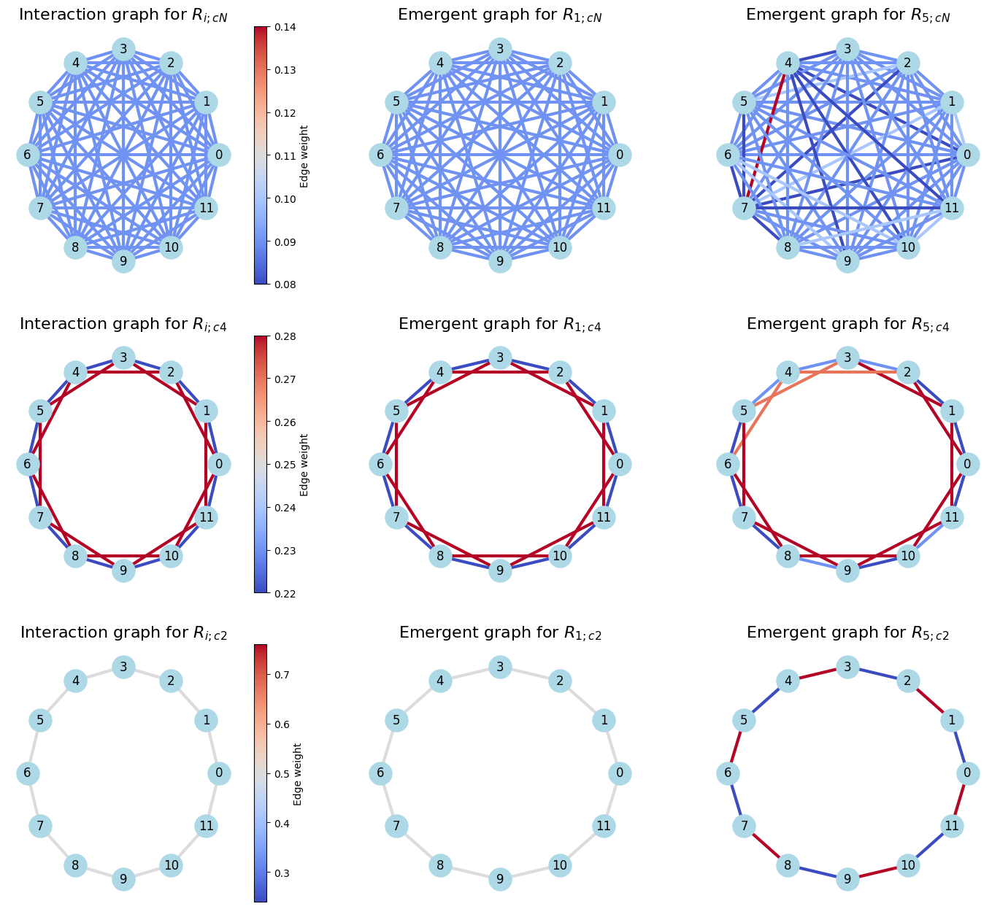

In [59]:
# Function to visualize the average adjacency matrix
def visualize_network(adj_matrix, ax, title, pos, cmap,minv,maxv,cmap_visual="False"):
    """
    Visualizes a network based on the provided adjacency matrix.
    """
    # Create a graph
    G = nx.from_numpy_array(adj_matrix)  # Use from_numpy_array instead of from_numpy_matrix

    
    # Normalize the weights for color mapping
    weights = np.array([G[u][v]['weight'] for u, v in G.edges()])
    norm = plt.Normalize(vmin=minv, vmax=maxv)

    # Map edge weights to colors using the given colormap
    edge_colors = [cmap(norm(w)) for w in weights]

    # Scale edge thickness according to the weight (here using width factor for better visibility)
    #min_width = 0.5  # Minimum edge width (for visualization)
    #max_width = 5.0  # Maximum edge width (for visualization)
    #edge_widths = min_width + (weights - np.min(weights)) / (np.max(weights) - np.min(weights)) * (max_width - min_width)

    # Draw the graph with node labels
    nx.draw(G, pos, with_labels=True, node_color='lightblue', node_size=500,
            edge_color=edge_colors, width=3, ax=ax)

    # Draw edge labels to show weights
    #nx.draw_networkx_edge_labels(G, pos, edge_labels={(u, v): d['weight'] for u, v, d in G.edges(data=True)}, ax=ax)
    nx.draw_networkx_edge_labels(G, pos, edge_labels=False, ax=ax)


    # Add a color bar to show the weight scale
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    if cmap_visual == True:
        #plt.colorbar(sm, ax=ax, label="Edge weight")
        cbar = plt.colorbar(sm, ax=ax, label="Edge weight")
    
    # Get the colorbar axes
        cbar_ax = cbar.ax
    
    # You can then adjust the position of cbar_ax
        pos = cbar_ax.get_position()
        cbar_ax.set_position([pos.x0, pos.y0, pos.width, pos.height])

    # Add a title to each subplot
    ax.set_title(title,fontsize=16)


# Function to create color gradients

#fig, ax = plt.subplots(1, 1, figsize=(12, 12))
adjacency_matrix_cn = np.array([[0,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11],[1/11,0,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11],[1/11,1/11,0,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11],[1/11,1/11,1/11,0,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11],[1/11,1/11,1/11,1/11,0,1/11,1/11,1/11,1/11,1/11,1/11,1/11],[1/11,1/11,1/11,1/11,1/11,0,1/11,1/11,1/11,1/11,1/11,1/11],
                   [1/11,1/11,1/11,1/11,1/11,1/11,0,1/11,1/11,1/11,1/11,1/11],[1/11,1/11,1/11,1/11,1/11,1/11,1/11,0,1/11,1/11,1/11,1/11],[1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,0,1/11,1/11,1/11],[1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,0,1/11,1/11],[1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,0,1/11],[1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,1/11,0]])
adjacency_matrix_c4 = np.array([[ 0,  8/36, 10/36,  0,  0,  0,  0,  0,  0,  0, 10/36,  8/36,],
 [ 8/36,  0,  8/36, 10/36,  0,  0,  0,  0,  0,  0,  0, 10/36,],
 [10/36,  8/36,  0,  8/36, 10/36,  0,  0,  0,  0,  0,  0,  0,],
 [ 0, 10/36,  8/36,  0,  8/36, 10/36,  0,  0,  0,  0,  0,  0,],
 [ 0,  0, 10/36,  8/36,  0,  8/36, 10/36,  0,  0,  0,  0,  0,],
 [ 0,  0,  0, 10/36,  8/36,  0,  8/36, 10/36,  0,  0,  0,  0,],
 [ 0,  0,  0,  0, 10/36,  8/36,  0,  8/36, 10/36,  0,  0,  0,],
 [ 0,  0,  0,  0,  0, 10/36,  8/36,  0,  8/36, 10/36,  0,  0,],
 [ 0,  0,  0,  0,  0,  0, 10/36,  8/36,  0,  8/36, 10/36,  0,],
 [ 0,  0,  0,  0,  0,  0,  0, 10/36,  8/36,  0,  8/36, 10/36,],
 [10/36,  0,  0,  0,  0,  0,  0,  0, 10/36,  8/36,  0,  8/36,],
 [ 8/36, 10/36,  0,  0,  0,  0,  0,  0,  0, 10/36,  8/36,  0,]])

adjacency_matrix_c2 = np.array([[0,1/2,0,0,0,0,0,0,0,0,0,1/2],
                    [1/2,0,1/2,0,0,0,0,0,0,0,0,0],
                    [0,1/2,0,1/2,0,0,0,0,0,0,0,0],
                    [0,0,1/2,0,1/2,0,0,0,0,0,0,0],
                    [0,0,0,1/2,0,1/2,0,0,0,0,0,0],
                    [0,0,0,0,1/2,0,1/2,0,0,0,0,0],
                    [0,0,0,0,0,1/2,0,1/2,0,0,0,0],
                    [0,0,0,0,0,0,1/2,0,1/2,0,0,0],
                    [0,0,0,0,0,0,0,1/2,0,1/2,0,0],
                    [0,0,0,0,0,0,0,0,1/2,0,1/2,0],
                    [0,0,0,0,0,0,0,0,0,1/2,0,1/2],
                    [1/2,0,0,0,0,0,0,0,0,0,1/2,0]])

adjacency_matrix_cn = np.round(adjacency_matrix_cn, 2)
print("CN Matrix (rounded to 2 decimal places):")
print(adjacency_matrix_cn)

# Round the adjacency matrix for C4 to 2 decimal places
adjacency_matrix_c4 = np.round(adjacency_matrix_c4, 2)
print("\nC4 Matrix (rounded to 2 decimal places):")
print(adjacency_matrix_c4)

# Round the adjacency matrix for C2 to 2 decimal places
adjacency_matrix_c2 = np.round(adjacency_matrix_c2, 2)
print("\nC2 Matrix (rounded to 2 decimal places):")
print(adjacency_matrix_c2)

# Define pastel shades for red and blue
pastel_red = "#ffb3ba"   # Soft pastel red
pastel_blue = "#b3cde3"  # Soft pastel blue

# Create a continuous gradient colormap
pastel_red_blue_cmap = LinearSegmentedColormap.from_list("pastel_red_blue", [pastel_red, pastel_blue], N=256)


#cmap = pastel_red_blue_cmap


cmap = cm.coolwarm
pos = nx.circular_layout(nx.from_numpy_array(compute_ensemble_average(outputs_R5_cn)))

# Call the visualize function
#visualize_network(compute_ensemble_average(outputs_R5_cn), ax, "Emergent network for $R_{5;cN}^{12Q}$", pos, cmap,minv,maxv)
#visualize_network(compute_ensemble_average(outputs_R1_cn), ax, "Emergent network for $R_{1;cN}^{12Q}$", pos, cmap,minv,maxv)
#visualize_network(adjacency_matrix, ax, "Interaction network for $R_{i;cN}^{12Q}$", pos, cmap,minv,maxv)
fig, axs = plt.subplots(3, 3, figsize=(15, 15))
plt.subplots_adjust(left=0.05, right=0.95, top=0.9, bottom=0.1, wspace=0.2)
#CN
arr = compute_ensemble_average(outputs_R5_cn)
minv = np.min(arr[arr > 0])
maxv=np.max(compute_ensemble_average(outputs_R5_cn))
visualize_network(compute_ensemble_average(outputs_R5_cn), axs[0,2], "Emergent graph for $R_{5;cN}$", pos, cmap,minv,maxv,cmap_visual=False)
visualize_network(compute_ensemble_average(outputs_R1_cn), axs[0,1], "Emergent graph for $R_{1;cN}$", pos, cmap,minv,maxv,cmap_visual=False)
visualize_network(adjacency_matrix_cn, axs[0,0], "Interaction graph for $R_{i;cN}$", pos, cmap,minv,maxv,cmap_visual=True)
#C4
arr = compute_ensemble_average(outputs_R5_c4)
minv = np.min(arr[arr > 0])
maxv=np.max(compute_ensemble_average(outputs_R5_c4))
visualize_network(compute_ensemble_average(outputs_R5_c4), axs[1,2], "Emergent graph for $R_{5;c4}$", pos, cmap,minv,maxv,cmap_visual=False)
visualize_network(compute_ensemble_average(outputs_R1_c4), axs[1,1], "Emergent graph for $R_{1;c4}$", pos, cmap,minv,maxv,cmap_visual=False)
visualize_network(adjacency_matrix_c4, axs[1,0], "Interaction graph for $R_{i;c4}$", pos, cmap,minv,maxv,cmap_visual=True)
#C2
arr = compute_ensemble_average(outputs_R5_c2)
minv = np.min(arr[arr > 0])
maxv=np.max(compute_ensemble_average(outputs_R5_c2))
visualize_network(compute_ensemble_average(outputs_R5_c2), axs[2,2], "Emergent graph for $R_{5;c2}$", pos, cmap,minv,maxv,cmap_visual=False)
visualize_network(compute_ensemble_average(outputs_R1_c2), axs[2,1], "Emergent graph for $R_{1;c2}$", pos, cmap,minv,maxv,cmap_visual=False)
visualize_network(adjacency_matrix_c2, axs[2,0], "Interaction graph for $R_{i;c2}$", pos, cmap,minv,maxv,cmap_visual=True)

#plt.tight_layout()
# Show the plot
plt.savefig("Emergent_graph_12_Q_IN_inhomo_v1_bar.png")
plt.show()

Adj_mat:[array([[0.  , 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.1 , 0.09,
        0.09],
       [0.09, 0.  , 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09,
        0.09],
       [0.09, 0.09, 0.  , 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09,
        0.09],
       [0.09, 0.09, 0.09, 0.  , 0.09, 0.1 , 0.09, 0.09, 0.09, 0.09, 0.09,
        0.09],
       [0.09, 0.09, 0.09, 0.09, 0.  , 0.09, 0.09, 0.09, 0.09, 0.09, 0.09,
        0.09],
       [0.09, 0.09, 0.09, 0.1 , 0.09, 0.  , 0.09, 0.09, 0.09, 0.09, 0.09,
        0.09],
       [0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.  , 0.09, 0.09, 0.09, 0.09,
        0.09],
       [0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.  , 0.09, 0.09, 0.09,
        0.09],
       [0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.  , 0.09, 0.09,
        0.09],
       [0.1 , 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.  , 0.09,
        0.09],
       [0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.  ,
        0.09],
       [0.09

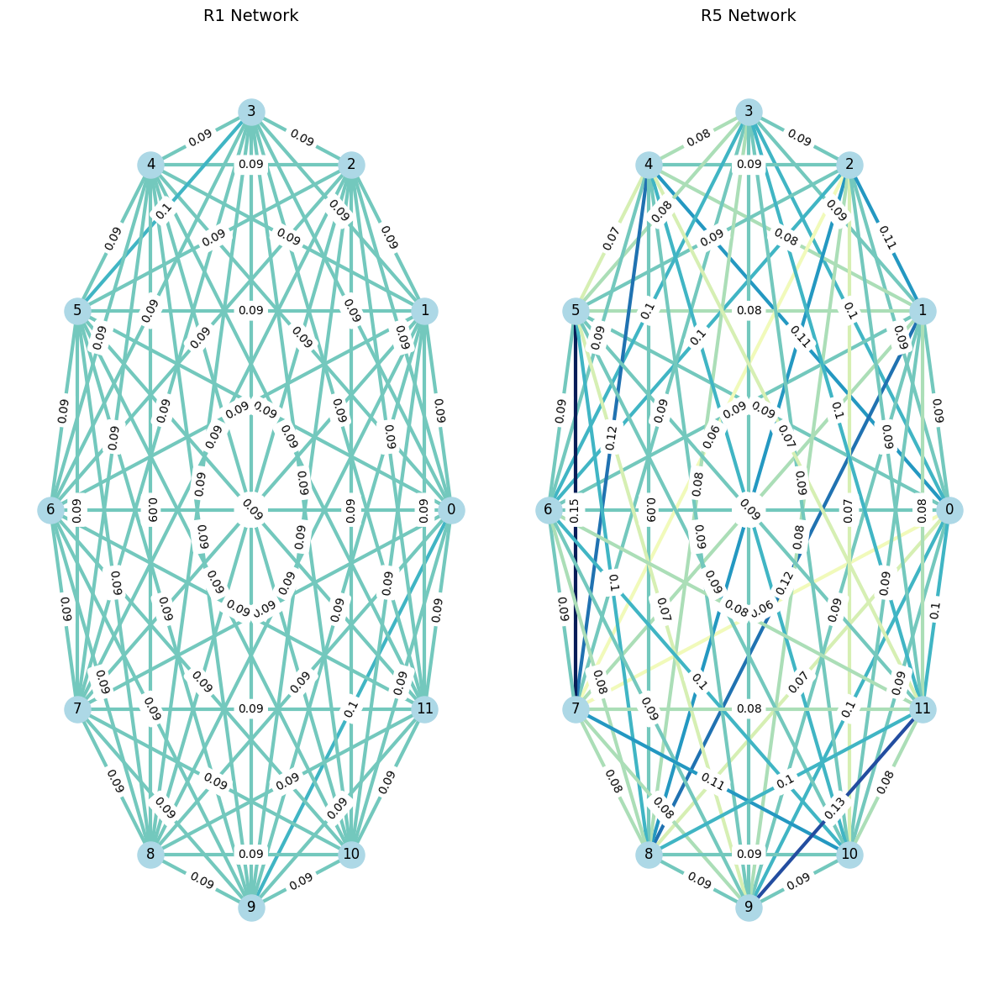

In [74]:
##########
datasets=[[outputs_R1_cn,outputs_R5_cn]]
conn_names = ['cN']
# Example: four different datasets of node pairs (replace with your real data)
dataset_titles = ["R1 Network", "R5 Network"]

# Loop over datasets and connection names
for dataset, conn in zip(datasets, conn_names):
    # Define the layout for 5 subplots side by side (1 row, 5 columns)
    fig, axs = plt.subplots(1, 2, figsize=(12, 12))  # 1x5 grid of subplots (side by side)
    
    # Generate a consistent node position layout across all datasets
    # Flatten the datasets to extract individual nodes
    all_nodes = set([node for dataset in outputs_R1_cn for sublist in dataset for pair in sublist for node in pair])
    G_all = nx.Graph()
    G_all.add_nodes_from(all_nodes)
    pos = nx.circular_layout(G_all)  # Fixed layout for nodes
    
    # Colormaps for each dataset (optional: you can change these)
    colormaps = [cm.YlGnBu] * 5  # Assuming same colormap for all 5 plots
    
    adj_mats=[]
    # Visualize the ensemble average for each dataset type
    for i, data in enumerate(dataset):
        # Compute the ensemble average adjacency matrix for this dataset type
        adj_matrix = compute_ensemble_average(data)
        adj_mats.append(adj_matrix)
        # Plot the average adjacency matrix
        visualize_network(adj_matrix, axs[i], dataset_titles[i], pos, colormaps[i])
    print(f'Adj_mat:{adj_mats}')
    
    # Adjust layout and display the plot
    plt.tight_layout()
    #plt.savefig(f'Emergent_interaction_network_{size}q_conn_{conn}_all_rule_ensembled_average_{dataset_label}.pdf', format='pdf', bbox_inches='tight')
    plt.show()

In [78]:

#plot the adjacency matrix
# Your adjacency matrix
adj_matrix = np.array([[0.    , 0.4755, 0.    , 0.    , 0.    , 0.    , 0.    , 0.5245],
                       [0.4755, 0.    , 0.5245, 0.    , 0.    , 0.    , 0.    , 0.    ],
                       [0.    , 0.5245, 0.    , 0.4755, 0.    , 0.    , 0.    , 0.    ],
                       [0.    , 0.    , 0.4755, 0.    , 0.5245, 0.    , 0.    , 0.    ],
                       [0.    , 0.    , 0.    , 0.5245, 0.    , 0.4755, 0.    , 0.    ],
                       [0.    , 0.    , 0.    , 0.    , 0.4755, 0.    , 0.5245, 0.    ],
                       [0.    , 0.    , 0.    , 0.    , 0.    , 0.5245, 0.    , 0.4755],
                       [0.5245, 0.    , 0.    , 0.    , 0.    , 0.    , 0.4755, 0.    ]])

# Create the plot
#plt.figure(figsize=(8, 6))

# Use seaborn heatmap for better visualization
#sns.heatmap(adj_matrix, cmap='viridis', annot=True, fmt=".2f", cbar=True, 
 #           linewidths=0.5, linecolor='gray', square=True, 
  #          cbar_kws={"label": "Connection Strength"})

# Add titles and labels (if necessary)
#plt.title("Adjacency Matrix with Viridis Colormap")
#plt.xlabel("Node Index")
#plt.ylabel("Node Index")

# Show the plot
#plt.show()
################

adj_mats

[array([[0.  , 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.1 , 0.09,
         0.09],
        [0.09, 0.  , 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09,
         0.09],
        [0.09, 0.09, 0.  , 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09,
         0.09],
        [0.09, 0.09, 0.09, 0.  , 0.09, 0.1 , 0.09, 0.09, 0.09, 0.09, 0.09,
         0.09],
        [0.09, 0.09, 0.09, 0.09, 0.  , 0.09, 0.09, 0.09, 0.09, 0.09, 0.09,
         0.09],
        [0.09, 0.09, 0.09, 0.1 , 0.09, 0.  , 0.09, 0.09, 0.09, 0.09, 0.09,
         0.09],
        [0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.  , 0.09, 0.09, 0.09, 0.09,
         0.09],
        [0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.  , 0.09, 0.09, 0.09,
         0.09],
        [0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.  , 0.09, 0.09,
         0.09],
        [0.1 , 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.  , 0.09,
         0.09],
        [0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.09, 0.  ,
         0.09],

Adj_mat:[array([[0.  , 0.49, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
        0.51],
       [0.49, 0.  , 0.51, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.51, 0.  , 0.49, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.49, 0.  , 0.51, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.51, 0.  , 0.49, 0.  , 0.  , 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.49, 0.  , 0.51, 0.  , 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.51, 0.  , 0.49, 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.49, 0.  , 0.51, 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.51, 0.  , 0.49, 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.49, 0.  , 0.51,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.51, 0.  ,
        0.49],
       [0.51

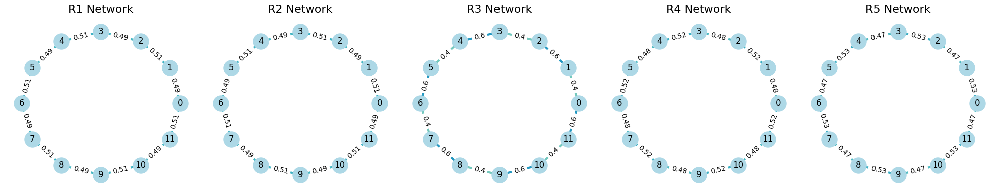

Adj_mat:[array([[0.  , 0.22, 0.28, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.28,
        0.22],
       [0.22, 0.  , 0.22, 0.28, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
        0.28],
       [0.28, 0.22, 0.  , 0.22, 0.28, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.28, 0.22, 0.  , 0.22, 0.27, 0.  , 0.  , 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.28, 0.22, 0.  , 0.22, 0.28, 0.  , 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.27, 0.22, 0.  , 0.22, 0.28, 0.  , 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.28, 0.22, 0.  , 0.23, 0.27, 0.  , 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.28, 0.23, 0.  , 0.22, 0.27, 0.  ,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.27, 0.22, 0.  , 0.22, 0.28,
        0.  ],
       [0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.27, 0.22, 0.  , 0.22,
        0.28],
       [0.28, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.28, 0.22, 0.  ,
        0.22],
       [0.22

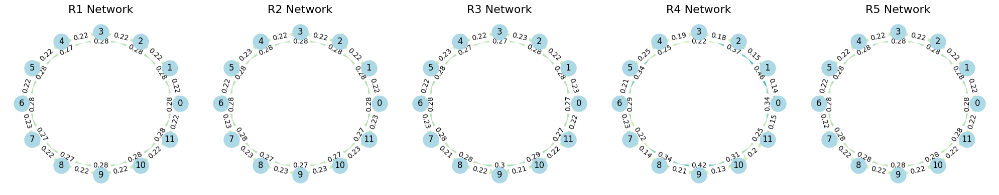

In [51]:
dataset_label="pure"
datasets=[[outputs_R1_c2, outputs_R2_c2, outputs_R3_c2,outputs_R4_c2,outputs_R5_c2],[outputs_R1_c4,outputs_R2_c4, outputs_R3_c4, outputs_R4_c4,outputs_R5_c4]]
conn_names = ['c2', 'c4']
# Example: four different datasets of node pairs (replace with your real data)
dataset_titles = ["R1 Network", "R2 Network","R3 Network", "R4 Network", "R5 Network"]

# Loop over datasets and connection names
for dataset, conn in zip(datasets, conn_names):
    # Define the layout for 5 subplots side by side (1 row, 5 columns)
    fig, axs = plt.subplots(1, 5, figsize=(20, 4))  # 1x5 grid of subplots (side by side)
    
    # Generate a consistent node position layout across all datasets
    # Flatten the datasets to extract individual nodes
    all_nodes = set([node for dataset in outputs_R1_c2 for sublist in dataset for pair in sublist for node in pair])
    G_all = nx.Graph()
    G_all.add_nodes_from(all_nodes)
    pos = nx.circular_layout(G_all)  # Fixed layout for nodes
    
    # Colormaps for each dataset (optional: you can change these)
    colormaps = [cm.YlGnBu] * 5  # Assuming same colormap for all 5 plots
    
    adj_mats=[]
    # Visualize the ensemble average for each dataset type
    for i, data in enumerate(dataset):
        # Compute the ensemble average adjacency matrix for this dataset type
        adj_matrix = compute_ensemble_average(data)
        adj_mats.append(adj_matrix)
        # Plot the average adjacency matrix
        visualize_network(adj_matrix, axs[i], dataset_titles[i], pos, colormaps[i],0,1)
    print(f'Adj_mat:{adj_mats}')
    
    # Adjust layout and display the plot
    plt.tight_layout()
    plt.savefig(f'Emergent_interaction_network_{size}q_conn_{conn}_all_rule_12_Q_ensembled_average_{dataset_label}.pdf', format='pdf', bbox_inches='tight')
    plt.show()

In [157]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Convert the adjacency matrix to a 1D array, excluding diagonal zeros
adj_matrix = np.array([[0.  , 0.09, 0.09, 0.1 , 0.11, 0.09, 0.09, 0.06, 0.07, 0.1 , 0.09, 0.1 ],
        [0.09, 0.  , 0.11, 0.09, 0.08, 0.08, 0.09, 0.08, 0.12, 0.09, 0.09, 0.08],
        [0.09, 0.11, 0.  , 0.09, 0.09, 0.09, 0.1 , 0.06, 0.11, 0.08, 0.07, 0.09],
        [0.1 , 0.09, 0.09, 0.  , 0.08, 0.08, 0.1 , 0.09, 0.08, 0.09, 0.09, 0.1 ],
        [0.11, 0.08, 0.09, 0.08, 0.  , 0.07, 0.09, 0.12, 0.09, 0.09, 0.1 , 0.07],
        [0.09, 0.08, 0.09, 0.08, 0.07, 0.  , 0.09, 0.15, 0.1 , 0.07, 0.09, 0.09],
        [0.09, 0.09, 0.1 , 0.1 , 0.09, 0.09, 0.  , 0.09, 0.08, 0.09, 0.1 , 0.08],
        [0.06, 0.08, 0.06, 0.09, 0.12, 0.15, 0.09, 0.  , 0.08, 0.08, 0.11, 0.08],
        [0.07, 0.12, 0.11, 0.08, 0.09, 0.1 , 0.08, 0.08, 0.  , 0.09, 0.09, 0.1 ],
        [0.1 , 0.09, 0.08, 0.09, 0.09, 0.07, 0.09, 0.08, 0.09, 0.  , 0.09, 0.13],
        [0.09, 0.09, 0.07, 0.09, 0.1 , 0.09, 0.1 , 0.11, 0.09, 0.09, 0.  , 0.08],
        [0.1 , 0.08, 0.09, 0.1 , 0.07, 0.09, 0.08, 0.08, 0.1 , 0.13, 0.08, 0.  ]])

# Get non-diagonal elements
values = adj_matrix[~np.eye(adj_matrix.shape[0], dtype=bool)]

# Create figure
plt.figure(figsize=(12, 6))

# Create histogram with KDE
sns.histplot(data=values, bins=20, stat='density', alpha=0.6)
sns.kdeplot(data=values, color='red', linewidth=2)

# Add vertical line at 0.09
plt.axvline(x=0.09, color='green', linestyle='--', label='Center (0.09)')

# Add basic statistics
mean_val = np.mean(values)
std_val = np.std(values)
plt.axvline(x=mean_val, color='blue', linestyle=':', label=f'Mean ({mean_val:.3f})')

# Customize plot
plt.title('Distribution of Adjacency Matrix Values', pad=20)
plt.xlabel('Values')
plt.ylabel('Density')

# Add text box with statistics
stats_text = f'Mean: {mean_val:.3f}\nStd: {std_val:.3f}\nMin: {np.min(values):.3f}\nMax: {np.max(values):.3f}'
plt.text(0.95, 0.95, stats_text,
         transform=plt.gca().transAxes,
         verticalalignment='top',
         horizontalalignment='right',
         bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

# Print numerical summary
print("\nNumerical Summary:")
print(f"Number of edges (excluding diagonal): {len(values)}")
print(f"Percentage of values between 0.08 and 0.10: {np.mean((values >= 0.08) & (values <= 0.10)) * 100:.1f}%")

ModuleNotFoundError: No module named 'seaborn'

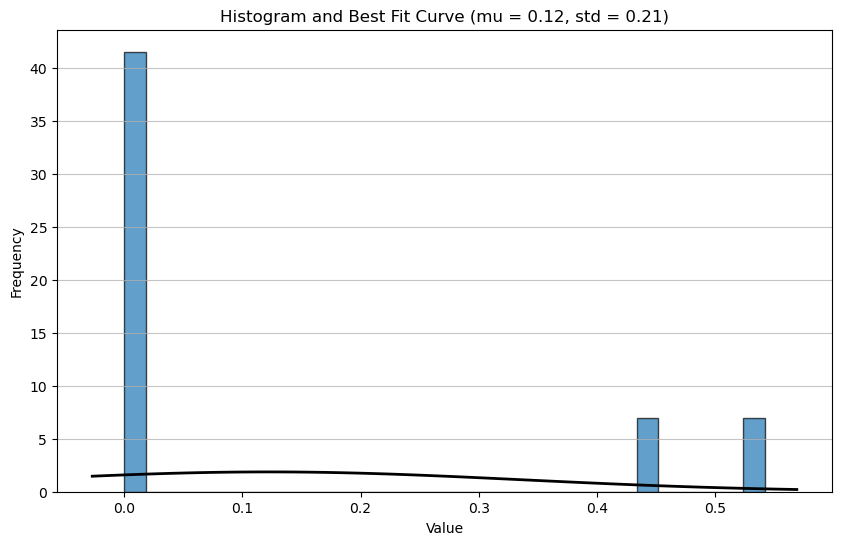

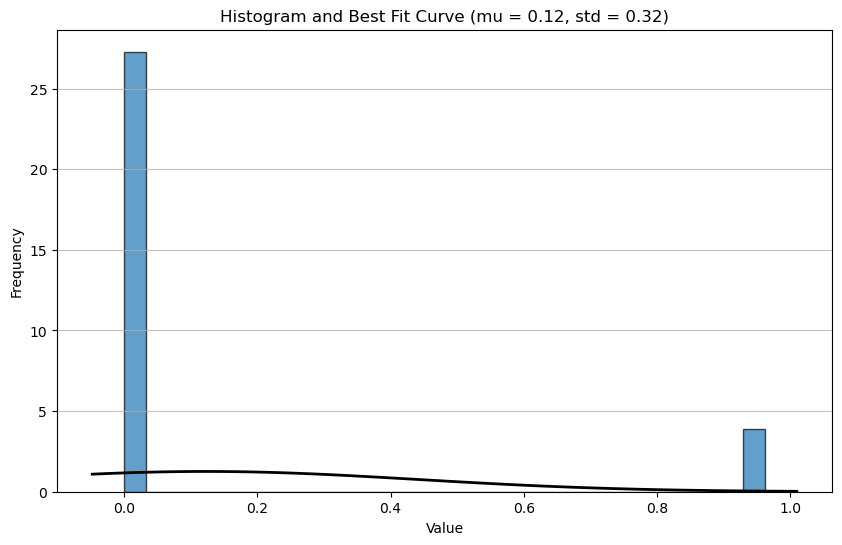

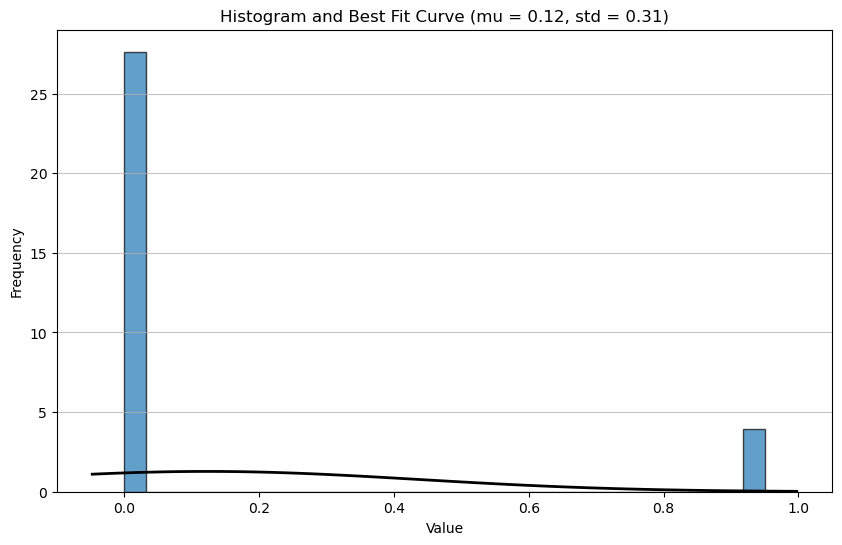

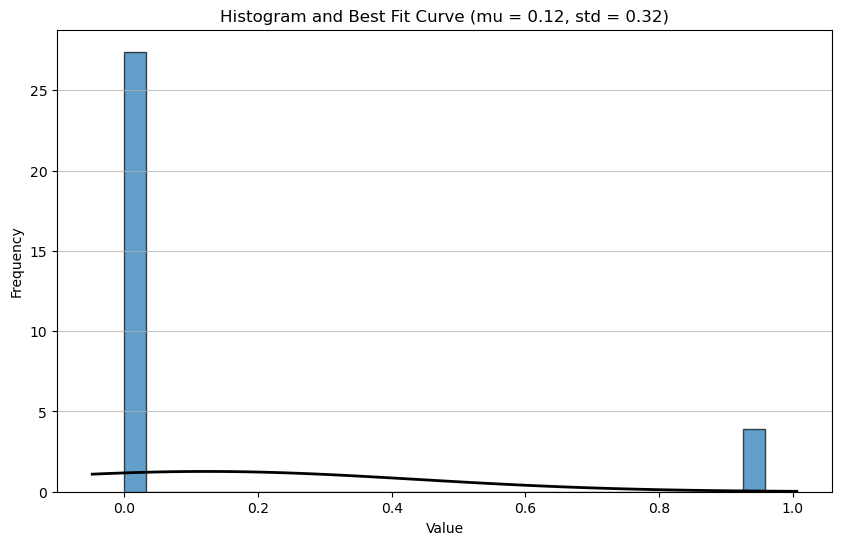

In [122]:
#Histogram with gaussian 
from scipy.stats import norm

# Give you have your adjacency matrix as a NumPy array
for adj_mat in [adjacency_matrices[0], adjacency_matrices[1], adjacency_matrices[2], adjacency_matrices[3]]:
    adjacency_matrix = adj_mat  # Replace with your desired adjacency matrix
    
    # Step 1: Flatten the adjacency matrix to a 1D array
    flattened_values = adjacency_matrix.flatten()
    
    # Step 2: Plot the histogram
    plt.figure(figsize=(10, 6))
    count, bins, ignored = plt.hist(flattened_values, bins=30, density=True, edgecolor='black', alpha=0.7)

    # Step 3: Fit the data to a normal distribution and plot the best fit curve
    mu, std = norm.fit(flattened_values)  # Mean and standard deviation of the best fit
    xmin, xmax = plt.xlim()  # Get the x-axis limits
    x = np.linspace(xmin, xmax, 100)
    p = norm.pdf(x, mu, std)  # Gaussian probability density function
    plt.plot(x, p, 'k', linewidth=2)  # Plot the fitted curve

    # Labels and title
    plt.title(f'Histogram and Best Fit Curve (mu = {mu:.2f}, std = {std:.2f})')
    plt.xlabel('Value')
    plt.ylabel('Frequency')

    plt.grid(axis='y', alpha=0.75)
    plt.show()

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


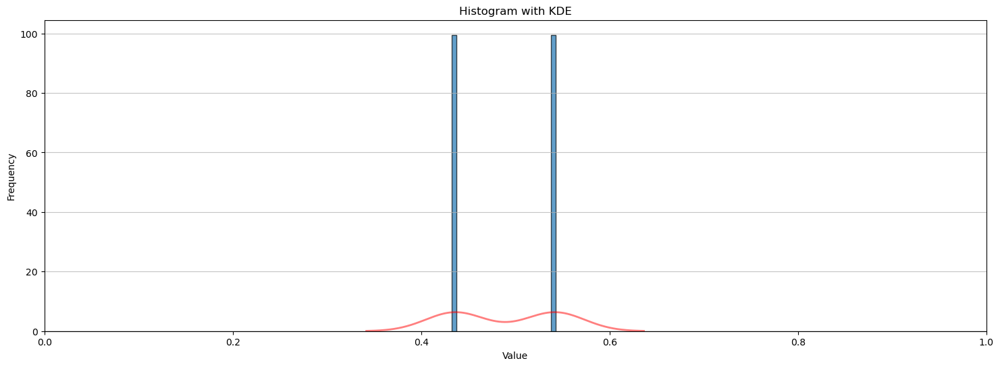

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


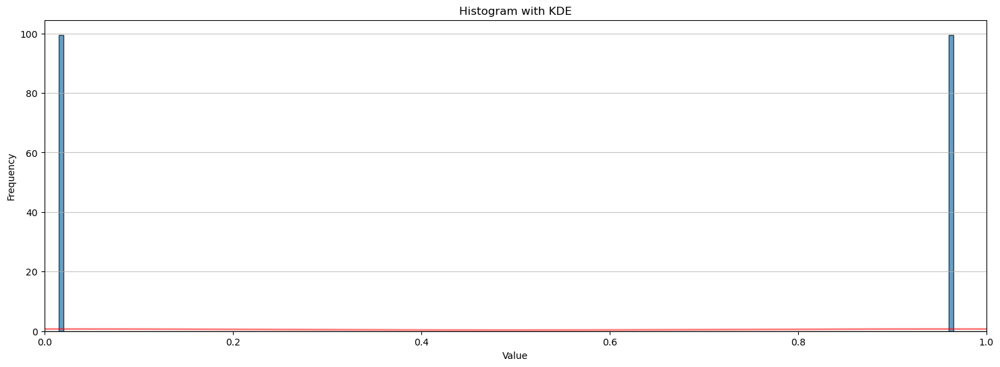

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


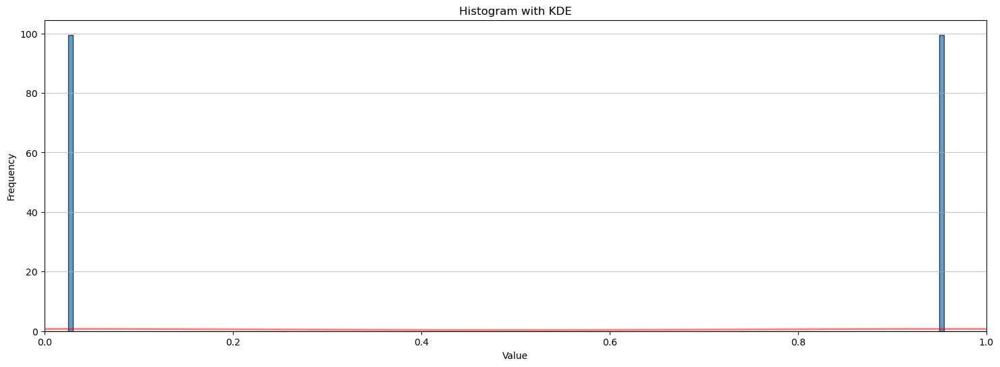

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


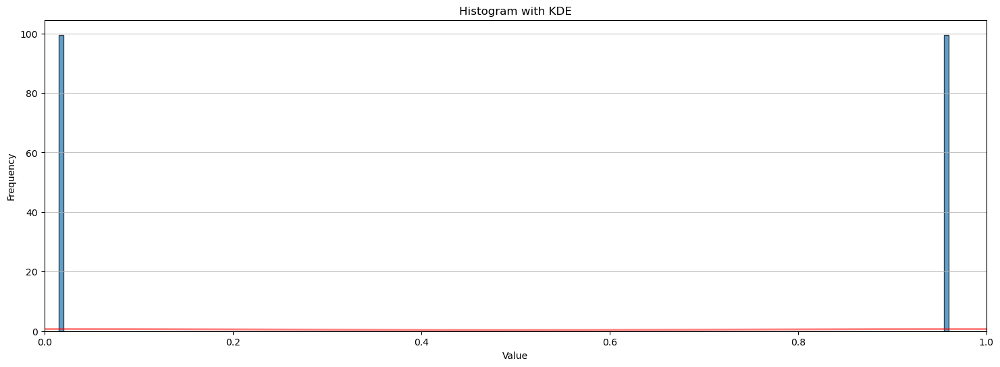

In [123]:
#Histogram with Kernal density estimate
import seaborn as sns

# Assume your adjacency matrix is processed as before
for adj_mat in [adjacency_matrices[0], adjacency_matrices[1], adjacency_matrices[2], adjacency_matrices[3]]:
    adjacency_matrix = adj_mat  # Replace with your desired adjacency matrix
    
    # Step 1: Flatten the adjacency matrix to a 1D array
    flattened_values = adjacency_matrix.flatten()
    
    # Step 2: Remove the zeros from the data
    flattened_values_nonzero = flattened_values[flattened_values != 0]
    
    # Step 3: Plot the histogram
    plt.figure(figsize=(18, 6))
    bins = np.linspace(0, 1, 200)  # 20 bins evenly spaced between 0 and 1
    plt.hist(flattened_values_nonzero, bins=bins, edgecolor='black', alpha=0.7, density=True)
    plt.xlim(left=0,right=1)  # Start x-axis from 1


    # Step 4: Plot the KDE (Kernel Density Estimate)
    sns.kdeplot(flattened_values_nonzero, color='red',alpha=0.5, linewidth=2)
    
    plt.title('Histogram with KDE')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(axis='y', alpha=0.75)
    plt.show()

In [241]:
# Network for a particular seed
# Function to visualize each dataset
def visualize_network(dataset, ax, title, pos, cmap):
    # Flatten the dataset into a list of tuples representing pairs
    edges = [tuple(sorted(pair)) for sublist in dataset for pair in sublist]
    vmin=0
    vmax=1

    # Count the number of times each node pair appears
    edge_weights = Counter(edges)

    # Create a graph
    G = nx.Graph()

    # Add edges along with their weights
    for edge, weight in edge_weights.items():
        G.add_edge(edge[0], edge[1], weight=np.round(weight/489,4))

    edges = list(G.edges)

    # Get the edge weights to visualize them
    weights = np.array([G[u][v]['weight'] for u, v in G.edges()])
    weights = np.round(weights, 4)

    # Normalize weights for color mapping
    norm = plt.Normalize(vmin, vmax)

    # Map edge weights to colors using the given colormap
    edge_colors = [cmap(norm(w)) for w in weights]

    # Draw the graph with node labels, use color to represent the weight
    nx.draw(G, pos, with_labels=True, node_color='lightblue', node_size=500,
            edge_color=edge_colors, width=2, ax=ax)

    # Draw edge labels to show weights
    nx.draw_networkx_edge_labels(G, pos, edge_labels={(u, v): d['weight'] for u, v, d in G.edges(data=True)}, ax=ax)

    # Add a color bar to show the weight scale
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    #plt.colorbar(sm, ax=ax, label="Edge weight")

    # Add a title to each subplot
    ax.set_title(title)

    n_nodes = max(max(edge) for edge in edges) + 1  # Ensure it covers all nodes
    adj_matrix = np.zeros((n_nodes, n_nodes))

    for (edge, weight) in zip(edges, weights):
        adj_matrix[edge[0], edge[1]] = weight
        adj_matrix[edge[1], edge[0]] = weight
    adj_matrix = np.round(adj_matrix, 4)

    print(f"Adjacency Matrix for {title}:\n{adj_matrix}\n")
    return adj_matrix

In [243]:
visualize_network(outputs_R5_c2[4], ax, "Network Visualization", pos, cmap)

Adjacency Matrix for Network Visualization:
[[0.    0.998 0.    0.    0.    0.    0.    0.002]
 [0.998 0.    0.002 0.    0.    0.    0.    0.   ]
 [0.    0.002 0.    0.998 0.    0.    0.    0.   ]
 [0.    0.    0.998 0.    0.002 0.    0.    0.   ]
 [0.    0.    0.    0.002 0.    0.998 0.    0.   ]
 [0.    0.    0.    0.    0.998 0.    0.002 0.   ]
 [0.    0.    0.    0.    0.    0.002 0.    0.998]
 [0.002 0.    0.    0.    0.    0.    0.998 0.   ]]



array([[0.   , 0.998, 0.   , 0.   , 0.   , 0.   , 0.   , 0.002],
       [0.998, 0.   , 0.002, 0.   , 0.   , 0.   , 0.   , 0.   ],
       [0.   , 0.002, 0.   , 0.998, 0.   , 0.   , 0.   , 0.   ],
       [0.   , 0.   , 0.998, 0.   , 0.002, 0.   , 0.   , 0.   ],
       [0.   , 0.   , 0.   , 0.002, 0.   , 0.998, 0.   , 0.   ],
       [0.   , 0.   , 0.   , 0.   , 0.998, 0.   , 0.002, 0.   ],
       [0.   , 0.   , 0.   , 0.   , 0.   , 0.002, 0.   , 0.998],
       [0.002, 0.   , 0.   , 0.   , 0.   , 0.   , 0.998, 0.   ]])

Adjacency Matrix for R1 Network:
[[0.     0.5256 0.     0.     0.     0.     0.     0.4744]
 [0.5256 0.     0.4744 0.     0.     0.     0.     0.    ]
 [0.     0.4744 0.     0.5256 0.     0.     0.     0.    ]
 [0.     0.     0.5256 0.     0.4744 0.     0.     0.    ]
 [0.     0.     0.     0.4744 0.     0.5256 0.     0.    ]
 [0.     0.     0.     0.     0.5256 0.     0.4744 0.    ]
 [0.     0.     0.     0.     0.     0.4744 0.     0.5256]
 [0.4744 0.     0.     0.     0.     0.     0.5256 0.    ]]

Adjacency Matrix for R2 Network:
[[0.     0.9673 0.     0.     0.     0.     0.     0.0327]
 [0.9673 0.     0.0327 0.     0.     0.     0.     0.    ]
 [0.     0.0327 0.     0.9673 0.     0.     0.     0.    ]
 [0.     0.     0.9673 0.     0.0327 0.     0.     0.    ]
 [0.     0.     0.     0.0327 0.     0.9673 0.     0.    ]
 [0.     0.     0.     0.     0.9673 0.     0.0327 0.    ]
 [0.     0.     0.     0.     0.     0.0327 0.     0.9673]
 [0.0327 0.     0.     0.     0.     0.     0.9

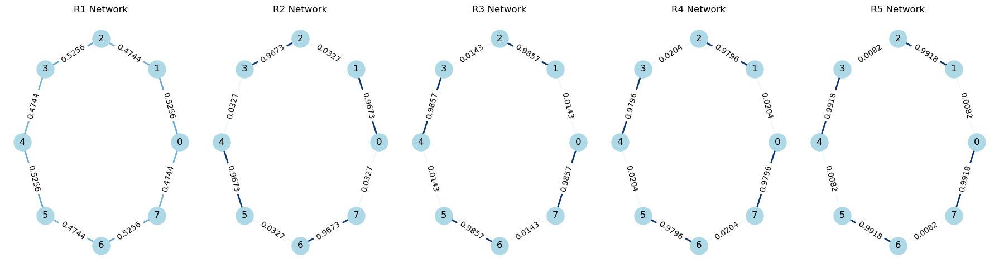

In [218]:
seed=3
conn='c2'
datasets = [outputs_R1_c2[seed], outputs_R2_c2[seed], outputs_R3_c2[seed], outputs_R4_c2[seed],outputs_R5_c2[seed]]  # Replace these with your actual datasets
dataset_titles = ["R1 Network", "R2 Network", "R3 Network", "R4 Network","R5 Network"]

# Define the layout and figure for the subplots (1x5 grid for 5 plots)
fig, axs = plt.subplots(1, 5, figsize=(18, 5))  # 1x5 grid of subplots

# Flatten the subplots array for easier indexing (it’s already 1D but this is for clarity)
axs = axs.flatten()

# Generate a consistent node position layout across all datasets
all_nodes = set([node for dataset in datasets for sublist in dataset for pair in sublist for node in pair])
G_all = nx.Graph()
G_all.add_nodes_from(all_nodes)
pos = nx.circular_layout(G_all)  # Fixed layout for nodes

# Colormaps for each dataset (optional: you can change these)
colormaps = [cm.Blues, cm.Blues, cm.Blues, cm.Blues, cm.Blues]  # Use the same colormap for simplicity

# Store adjacency matrices for further processing
adjacency_matrices = []

# Visualize each dataset in its respective subplot and output the adjacency matrix
for i, dataset in enumerate(datasets):
    ax = axs[i]  # Access the i-th subplot
    adj_matrix = visualize_network(dataset, ax, dataset_titles[i], pos, colormaps[i])
    adjacency_matrices.append(adj_matrix)  # Store the adjacency matrix in the list

# Adjust layout and display the plot
plt.tight_layout()
plt.savefig(f'Emergent_interaction_network_{size}q_conn_{conn}_all_rule_seed_{seed}_{dataset_label}.pdf', format='pdf', bbox_inches='tight')
plt.show()
# Further processing with adjacency_matrices if needed
# Now adjacency_matrices is a list of NumPy arrays



Adjacency Matrix for R1 Network:
[[  0.  33. 109.   0.   0.   0. 235. 112.]
 [ 33.   0. 143. 174.   0.   0.   0. 139.]
 [109. 143.   0.  72. 165.   0.   0.   0.]
 [  0. 174.  72.   0. 102. 141.   0.   0.]
 [  0.   0. 165. 102.   0. 144.  78.   0.]
 [  0.   0.   0. 141. 144.   0.  71. 133.]
 [235.   0.   0.   0.  78.  71.   0. 105.]
 [112. 139.   0.   0.   0. 133. 105.   0.]]

Adjacency Matrix for R2 Network:
[[  0.  86. 185.   0.   0.   0. 135.  83.]
 [ 86.   0.  86. 130.   0.   0.   0. 187.]
 [185.  86.   0.  95. 123.   0.   0.   0.]
 [  0. 130.  95.   0. 108. 156.   0.   0.]
 [  0.   0. 123. 108.   0.  91. 167.   0.]
 [  0.   0.   0. 156.  91.   0. 105. 137.]
 [135.   0.   0.   0. 167. 105.   0.  82.]
 [ 83. 187.   0.   0.   0. 137.  82.   0.]]

Adjacency Matrix for R3 Network:
[[  0. 116. 128.   0.   0.   0. 149.  96.]
 [116.   0. 106. 127.   0.   0.   0. 140.]
 [128. 106.   0. 125. 130.   0.   0.   0.]
 [  0. 127. 125.   0. 116. 121.   0.   0.]
 [  0.   0. 130. 116.   0. 100. 143. 

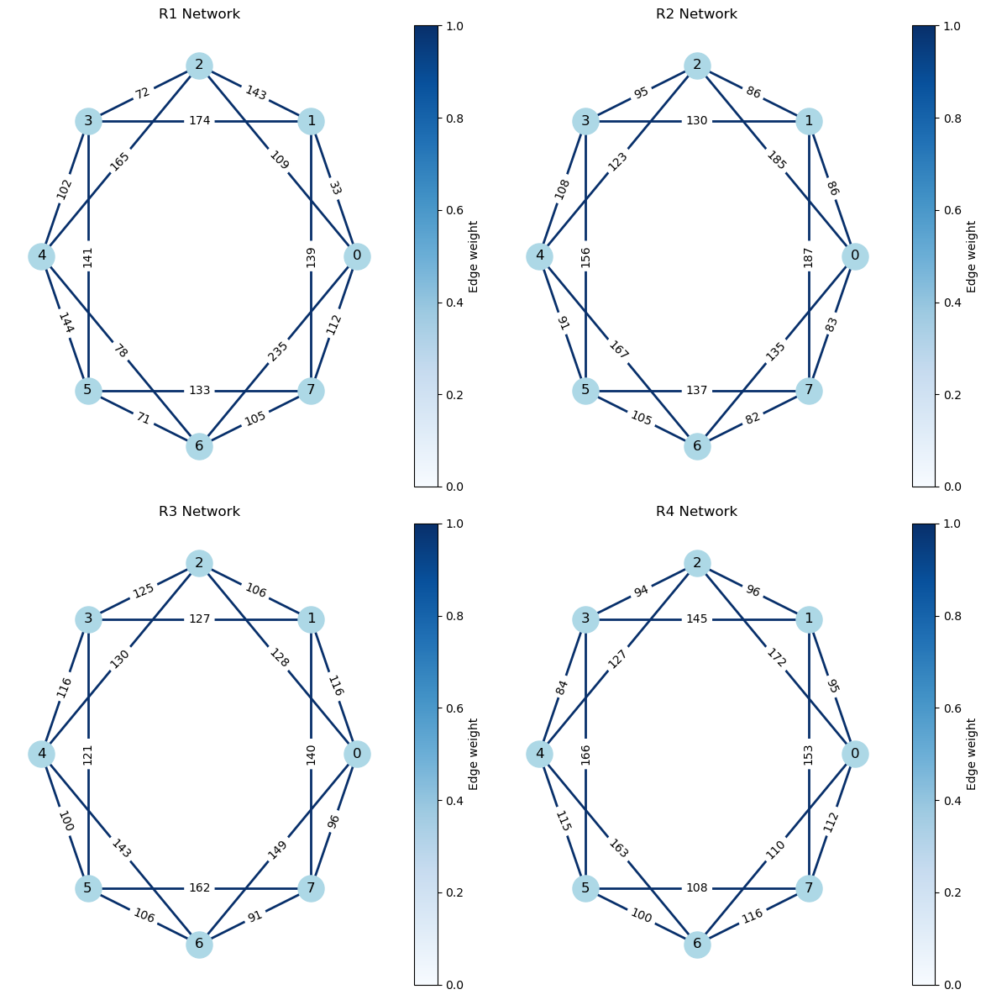

In [196]:
seed=5
conn='c4'
datasets = [outputs_R5_c4[seed], outputs_R2_c4[seed], outputs_R3_c4[seed], outputs_R4_c4[seed]]  # Replace these with your actual datasets
dataset_titles = ["R1 Network", "R2 Network", "R3 Network", "R4 Network"]

# Define the layout and figure for the subplots
fig, axs = plt.subplots(2, 2, figsize=(12, 12))  # 2x2 grid of subplots

# Generate a consistent node position layout across all datasets
# Flatten the datasets to extract individual nodes, assuming each sublist contains node pairs
all_nodes = set([node for dataset in datasets for sublist in dataset for pair in sublist for node in pair])
G_all = nx.Graph()
G_all.add_nodes_from(all_nodes)
pos = nx.circular_layout(G_all)  # Fixed layout for nodes

# Colormaps for each dataset (optional: you can change these)
colormaps = [cm.Blues, cm.Blues, cm.Blues, cm.Blues]

# Store adjacency matrices for further processing
adjacency_matrices = []

# Visualize each dataset in its respective subplot and output the adjacency matrix
for i, dataset in enumerate(datasets):
    row, col = divmod(i, 2)
    adj_matrix = visualize_network(dataset, axs[row, col], dataset_titles[i], pos, colormaps[i])
    #store all adjacency matrices in a list
    adjacency_matrices.append(adj_matrix)  # Store the matrix in a list

# Adjust layout and display the plot
plt.tight_layout()
plt.savefig(f'Emergent_interaction_network_{size}q_conn_{conn}_all_rule_seed_{seed}_{dataset_label}.pdf', format='pdf', bbox_inches='tight')
plt.show()

# Further processing with adjacency_matrices if needed
# Now adjacency_matrices is a list of NumPy arrays

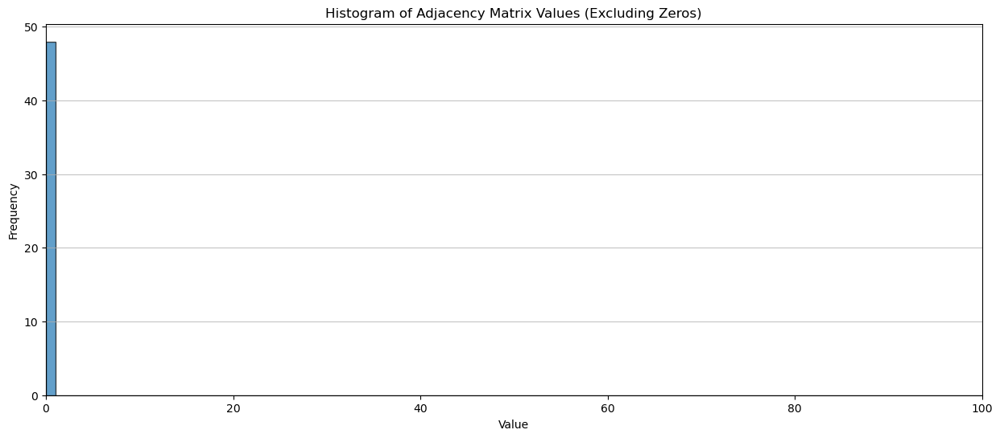

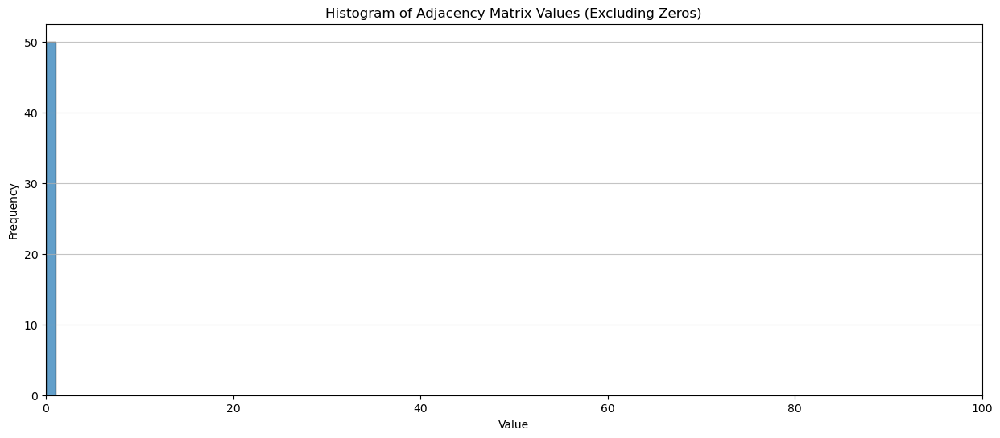

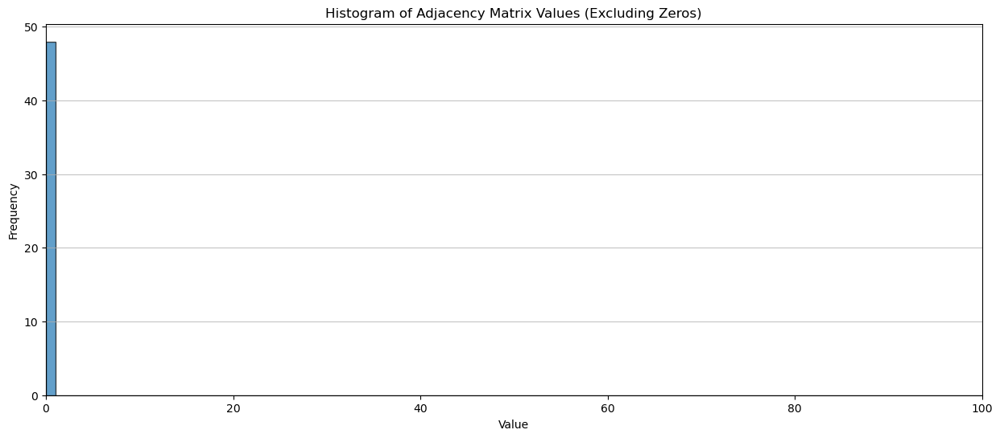

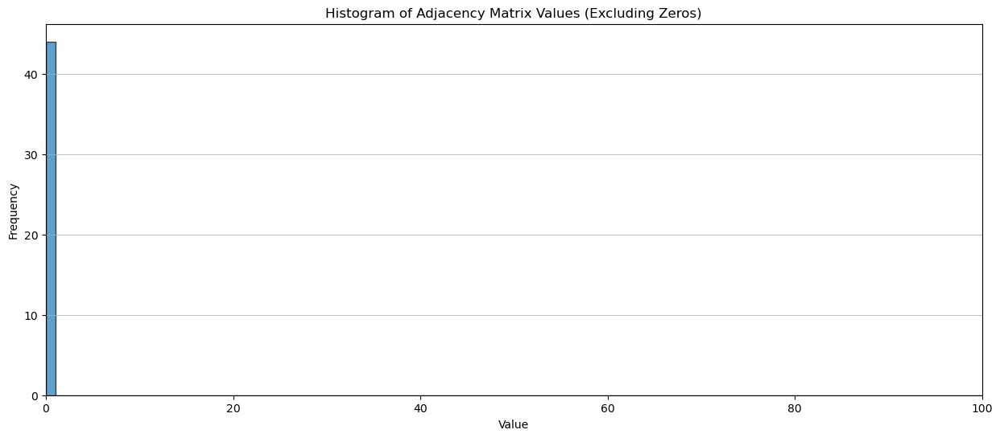

In [111]:
#Histogram of weight distribution
# Assume you have your adjacency matrix as a NumPy array
# For example, you can use the first adjacency matrix from your previous computation
for adj_mat in [adjacency_matrices[0], adjacency_matrices[1], adjacency_matrices[2], adjacency_matrices[3]]:
    adjacency_matrix = adj_mat  # Replace with your desired adjacency matrix
    
    # Step 1: Flatten the adjacency matrix to a 1D array
    flattened_values = adjacency_matrix.flatten()
    
    # Step 2: Remove the zeros from the data
    flattened_values_nonzero = flattened_values[flattened_values != 0]
    
    # Step 3: Plot the histogram
    plt.figure(figsize=(15, 6))
    bins = np.linspace(0, 100, 100)
    plt.hist(flattened_values_nonzero, bins=bins, edgecolor='black', alpha=0.7)
    plt.xlim(left=0,right=100)  # Start x-axis from 1
    plt.title('Histogram of Adjacency Matrix Values (Excluding Zeros)')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(axis='y', alpha=0.75)
    plt.show()


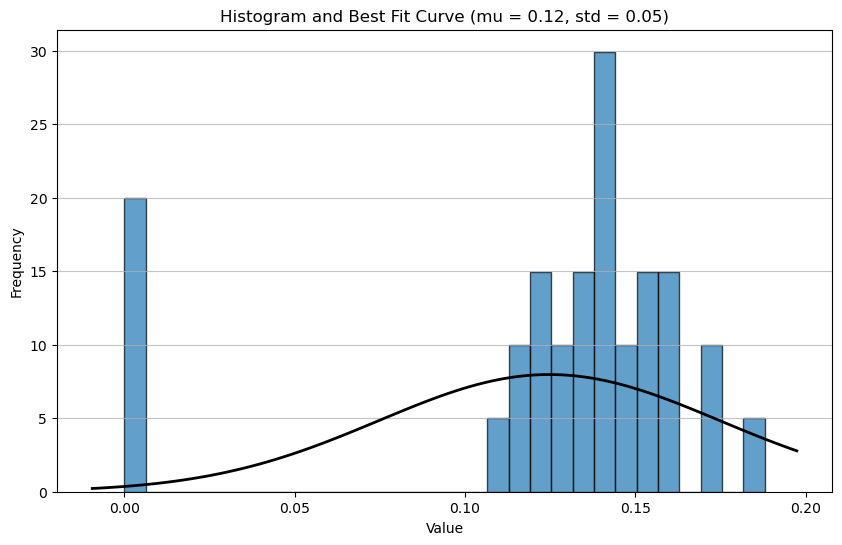

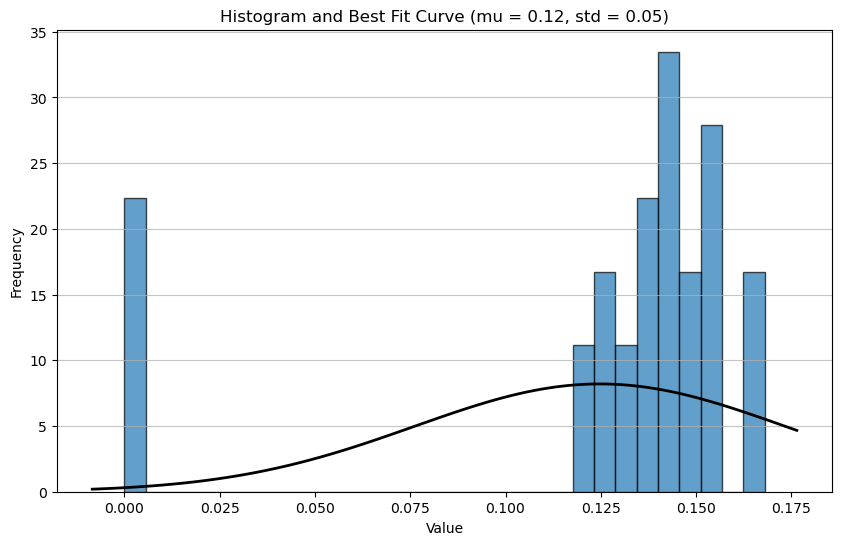

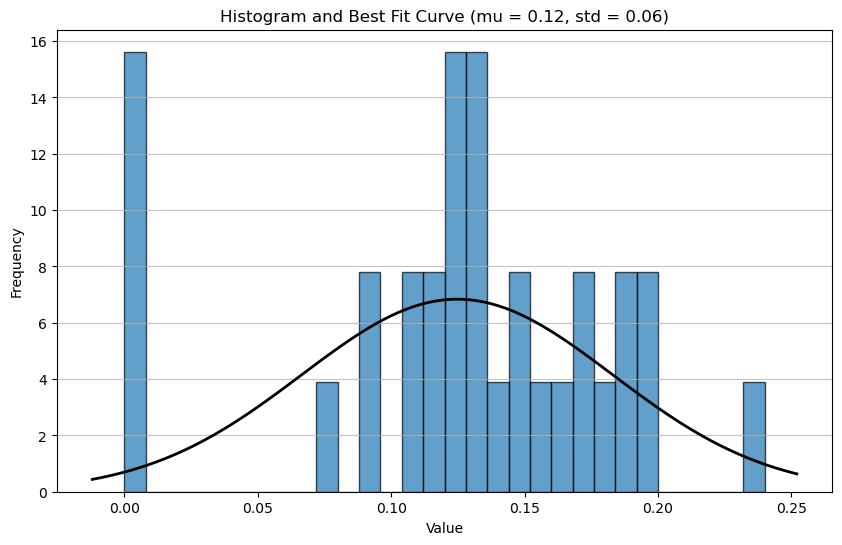

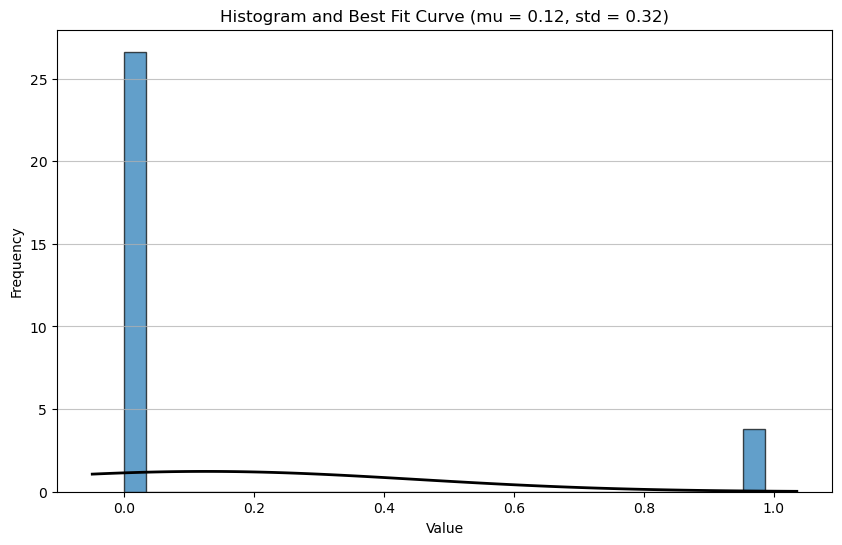

In [33]:
#Histogram with gaussian fit
from scipy.stats import norm

# Assume you have your adjacency matrix as a NumPy array
# For example, using the first adjacency matrix from your previous computation
for adj_mat in [adjacency_matrices[0], adjacency_matrices[1], adjacency_matrices[2], adjacency_matrices[3]]:
    adjacency_matrix = adj_mat  # Replace with your desired adjacency matrix
    
    # Step 1: Flatten the adjacency matrix to a 1D array
    flattened_values = adjacency_matrix.flatten()
    
    # Step 2: Plot the histogram
    plt.figure(figsize=(10, 6))
    count, bins, ignored = plt.hist(flattened_values, bins=30, density=True, edgecolor='black', alpha=0.7)

    # Step 3: Fit the data to a normal distribution and plot the best fit curve
    mu, std = norm.fit(flattened_values)  # Mean and standard deviation of the best fit
    xmin, xmax = plt.xlim()  # Get the x-axis limits
    x = np.linspace(xmin, xmax, 100)
    p = norm.pdf(x, mu, std)  # Gaussian probability density function
    plt.plot(x, p, 'k', linewidth=2)  # Plot the fitted curve

    # Labels and title
    plt.title(f'Histogram and Best Fit Curve (mu = {mu:.2f}, std = {std:.2f})')
    plt.xlabel('Value')
    plt.ylabel('Frequency')

    plt.grid(axis='y', alpha=0.75)
    plt.show()


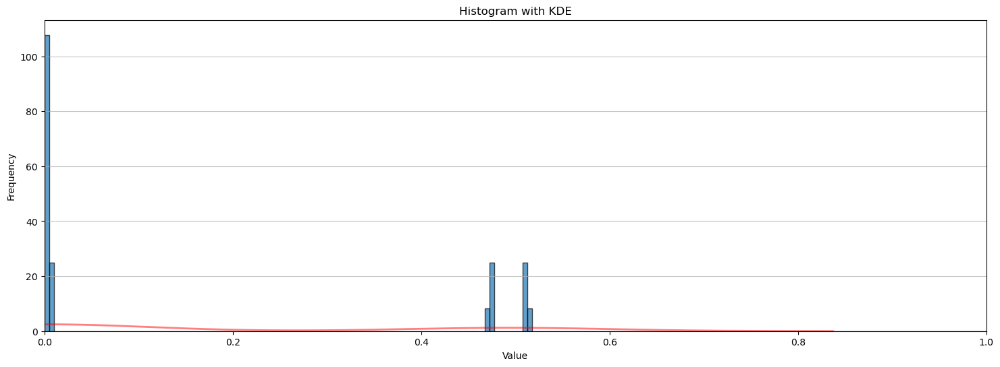

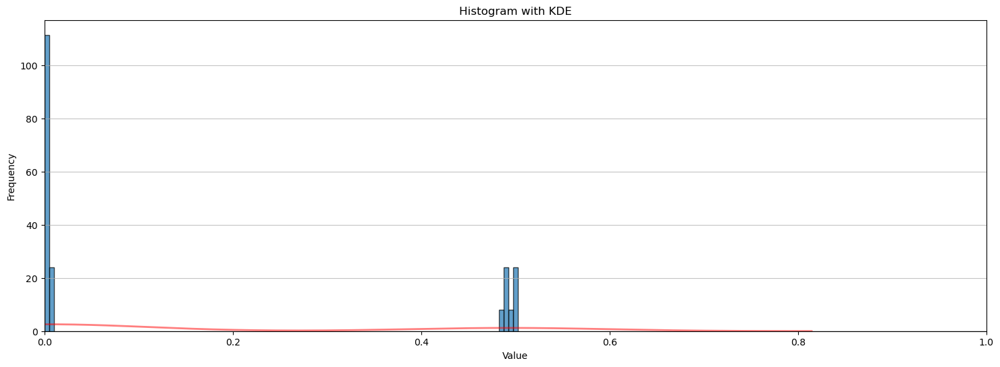

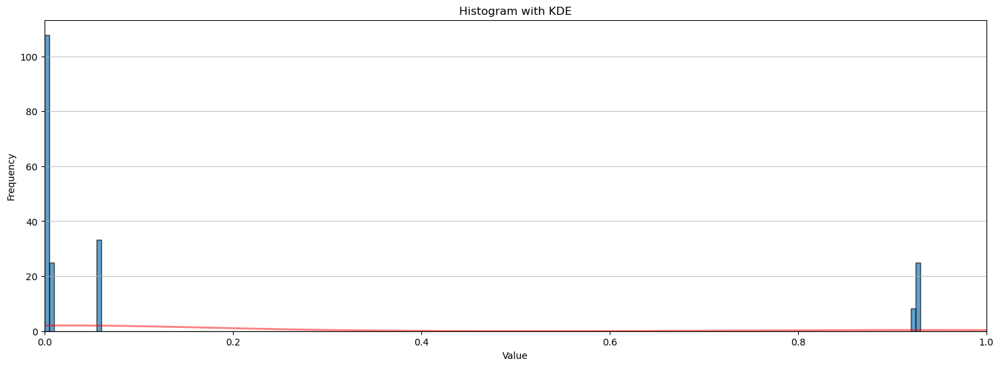

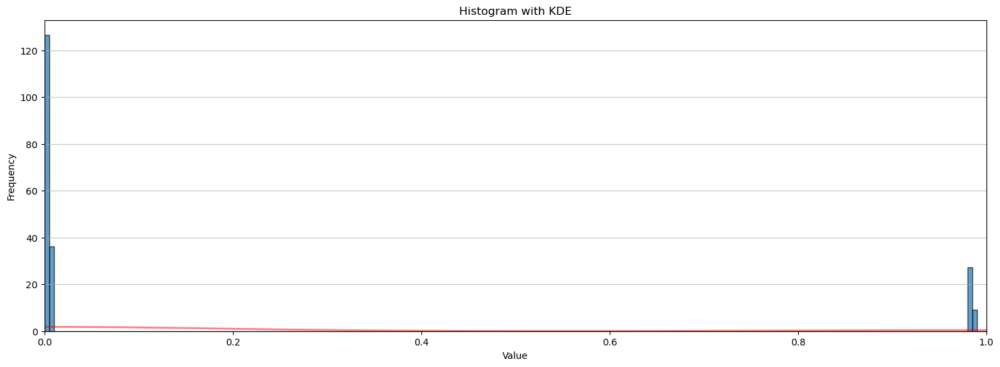

In [113]:
#Histogram with Kernal density estimate
import seaborn as sns

# Assume your adjacency matrix is processed as before
for adj_mat in [adjacency_matrices[0], adjacency_matrices[1], adjacency_matrices[2], adjacency_matrices[3]]:
    adjacency_matrix = adj_mat  # Replace with your desired adjacency matrix
    
    # Step 1: Flatten the adjacency matrix to a 1D array
    flattened_values = adjacency_matrix.flatten()
    
    # Step 2: Remove the zeros from the data
    flattened_values_nonzero = flattened_values[flattened_values != 0]
    
    # Step 3: Plot the histogram
    plt.figure(figsize=(18, 6))
    bins = np.linspace(0, 1, 200)  # 20 bins evenly spaced between 0 and 1
    plt.hist(flattened_values_nonzero, bins=bins, edgecolor='black', alpha=0.7, density=True)
    plt.xlim(left=0,right=1)  # Start x-axis from 1


    # Step 4: Plot the KDE (Kernel Density Estimate)
    sns.kdeplot(flattened_values_nonzero, color='red',alpha=0.5, linewidth=2)
    
    plt.title('Histogram with KDE')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(axis='y', alpha=0.75)
    plt.show()


In [ ]:
Averaging by looking at spectral property 

In [40]:
import numpy as np
import networkx as nx
from scipy.linalg import eigh

# Assume adjacency_matrices contains the adjacency matrices for your graphs
# Ensure that they are square matrices
graphs = [nx.from_numpy_array(adj) for adj in adjacency_matrices]

# Step 1: Compute the Laplacian for each graph
laplacians = [nx.laplacian_matrix(g).toarray() for g in graphs]

# Step 2: Compute eigenvalues and eigenvectors for each Laplacian
eigenvalues = []
eigenvectors = []
for lap in laplacians:
    eigvals, eigvecs = eigh(lap)  # eigh for symmetric matrices
    eigenvalues.append(eigvals)
    eigenvectors.append(eigvecs)

# Step 3: Average the eigenvalues and eigenvectors
avg_eigenvalues = np.mean(eigenvalues, axis=0)  # Average eigenvalues
avg_eigenvectors = np.mean(eigenvectors, axis=0)  # Average eigenvectors

# Step 4: Reconstruct the Laplacian from averaged eigenvalues/vectors (optional)
L_avg = avg_eigenvectors @ np.diag(avg_eigenvalues) @ avg_eigenvectors.T

# Convert the averaged Laplacian back to an adjacency matrix (optional)
D_avg = np.diag(np.sum(L_avg, axis=1))  # Reconstruct degree matrix
A_avg = D_avg - L_avg  # Reconstruct adjacency matrix

# Convert the adjacency matrix back to a networkx graph (optional)
G_avg = nx.from_numpy_array(A_avg)

# Output the average eigenvalues and the reconstructed graph (optional)
print("Average Eigenvalues:", avg_eigenvalues)
print("Average Laplacian:\n", L_avg)
print("Reconstructed Adjacency Matrix:\n", A_avg)


Average Eigenvalues: [4.61852778e-14 7.13413625e+01 7.50037897e+01 7.76544621e+01
 8.05312708e+01 1.28261615e+02 1.34124959e+02 1.37226129e+02
 1.40739598e+02 1.45116814e+02]
Average Laplacian:
 [[  9.33603638   3.85429213  -1.12657376  -3.30231875  -3.32239658
   -8.64063631  -2.34661785   6.25127228   4.17452607  -4.87758362]
 [  3.85429213  11.53572544  -3.39913207  -2.40699092  -5.84950113
  -12.28695232  -3.73364467   6.75417633  15.02369397  -9.49166677]
 [ -1.12657376  -3.39913207   7.25330355  -3.32971468   3.13641095
   -0.76633491  -9.79765262   3.76483052  -1.14197962   5.40684264]
 [ -3.30231875  -2.40699092  -3.32971468   7.51940557   0.44948258
    8.50255465   1.93654145  -4.46512182  -8.79346984   3.88963174]
 [ -3.32239658  -5.84950113   3.13641095   0.44948258  22.90847097
    8.18470477  -6.93445005  -7.82413127 -16.14710838   5.39851813]
 [ -8.64063631 -12.28695232  -0.76633491   8.50255465   8.18470477
   28.27028086   4.35074503 -14.32236324 -21.21664591   7.92464

In [83]:
from scipy.linalg import eigh
#from a network G find the laplacian
laplacians = [nx.laplacian_matrix(G).toarray()]

# Step 2: Compute eigenvalues and eigenvectors for each Laplacian
eigenvalues = []
eigenvectors = []
for lap in laplacians:
    eigvals, eigvecs = eigh(lap)  # eigh for symmetric matrices
    eigenvalues.append(eigvals)
    eigenvectors.append(eigvecs)
eigenvalues

[array([4.44089210e-16, 6.74219290e-02, 8.09973986e-02, 9.18479945e-02,
        1.18474816e-01, 1.87063284e+00, 1.89531498e+00, 1.91155701e+00,
        1.92209578e+00, 1.94165725e+00])]

In [ ]:
#Plot the laplacians
import matplotlib.pyplot as plt

# Example data (four lists of N points)
N = 10
x = list(range(N))  # X-axis points (0, 1, 2, ..., N-1)
y1 = average_laplacian_eigenvalues(np.array(MI_adj_random))[1]    # First list of N points
y2 = average_laplacian_eigenvalues(np.array(MI_adj_greedy))[1]   # Second list
y3 = average_laplacian_eigenvalues(np.array(MI_adj_mimic))[1]  # Third list
y4 = average_laplacian_eigenvalues(np.array(MI_adj_landmax))[1]  # Fourth list

# Plot each list on the same chart
plt.plot(x, y1, label='List 1', marker='o')  # Plot with markers
plt.plot(x, y2, label='List 2', marker='x')
plt.plot(x, y3, label='List 3', marker='s')
plt.plot(x, y4, label='List 4', marker='d')

# Add labels and title
plt.xlabel('X-axis')
plt.ylabel('Y-axis')
plt.title('Plot of 4 Lists on the Same Chart')

# Add a legend to distinguish between the lists
plt.legend()

# Show the plot
plt.show()

In [17]:
pops_rand = get_pops(newdata1,8,"c2_2local","random")
pops_greedy = get_pops(newdata2,8,"c5_2local","greedy")

In [56]:
pops_greedy[0][1]

array([0.10000001, 0.10000001, 0.10000002, 0.11296819, 0.38703185,
       0.10000001, 0.10000001, 0.10000001], dtype=float32)

In [48]:
outputs_R2_c5[0][0]

array([[0, 7],
       [2, 6],
       [3, 4],
       [1, 5]])

In [63]:
azfinal=(2*0.4-1)*np.cos(np.pi/15)*np.cos(np.pi/15) + (2*0.1-1)*np.sin(np.pi/15)*np.sin(np.pi/15)
pfinal=(azfinal+1)/2
pfinal

[[ 9, 10],
       [ 1,  2],
       [ 3,  4],
       [ 0, 11],
       [ 5,  6],
       [ 7,  8]]

np.float64(0.38703181864639014)